## Import Depedency

In [1]:
import urllib.request
import zipfile
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras import layers
from tensorflow.keras import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3

In [2]:
from tensorflow.keras.callbacks import ModelCheckpoint
import pickle
from google.colab import drive
import shutil
from distutils.dir_util import copy_tree

In [3]:
from google.colab import drive
import shutil
from distutils.dir_util import copy_tree

# Mount your Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


## Load the data from github

In [17]:
!git clone -b machine_learning https://github.com/fachrinnk4869/sugarWise.git

Cloning into 'sugarWise'...
remote: Enumerating objects: 20951, done.
remote: Counting objects: 100% (2249/2249), done.
remote: Compressing objects: 100% (2237/2237), done.
remote: Total 20951 (delta 16), reused 2238 (delta 10), pack-reused 18702
Receiving objects: 100% (20951/20951), 1.43 GiB | 32.52 MiB/s, done.
Resolving deltas: 100% (40/40), done.
Updating files: 100% (19057/19057), done.


## Create data augementasi

In [18]:
root_dir = '/content/sugarWise/data_fix'
# train_dir = os.path.join(root_dir)
val_dir = '/content/sugarWise/data_validation'

In [19]:
rm -rf `find -type d -name .ipynb_checkpoints`

In [23]:
training_datagen = ImageDataGenerator(
        rotation_range=30,
        width_shift_range=0.2,
        height_shift_range=0.2,
        zoom_range=0.3,
        horizontal_flip=True,
        rescale=1/255.0,
        fill_mode='nearest',
        validation_split=0.3
        )
validation_datagen = ImageDataGenerator(
    rescale=1/255.0,
    validation_split=0.3
    )

In [24]:
train_generator = training_datagen.flow_from_directory(
    directory = root_dir,
    batch_size = 32,
    class_mode = 'categorical',
    target_size = (150,150),
    color_mode = 'rgb',
)
val_generator = validation_datagen.flow_from_directory(
    directory = root_dir,
    batch_size = 8,
    class_mode = 'categorical',
    target_size = (150,150),
    color_mode = 'rgb',
    subset = 'validation',
)

Found 17459 images belonging to 16 classes.
Found 5231 images belonging to 16 classes.


## Define Model Using Inception V3

In [ ]:
inceptionv3 = 'https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'
urllib.request.urlretrieve(inceptionv3, 'inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5')
local_weights_file = 'inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'
pre_trained_model = InceptionV3(
        input_shape=(150, 150, 3),
        include_top=False,
        weights=None
    )
pre_trained_model.load_weights(local_weights_file)
for layer in pre_trained_model.layers:
  layer.trainable = False

pre_trained_model.summary()

In [ ]:
last_layer = pre_trained_model.get_layer('mixed8')
x = layers.Flatten()(last_layer.output)
x = layers.Dense(16, activation='softmax')(x)
model = Model(pre_trained_model.input, x)

### Define Model Checkpoint

In [ ]:
# callbacks checkpoint with save mode
class MyModelCheckpoint(ModelCheckpoint):
  def __init__(self, *args, **kwargs):
    super().__init__(*args, **kwargs)

  def on_epoch_end(self, epoch, logs=None):
    super().on_epoch_end(epoch,logs)\

    # Also save the optimizer state
    filepath = self._get_file_path(epoch=epoch,
        logs=logs, batch=None)
    filepath = filepath.rsplit( ".", 1 )[ 0 ]
    filepath += ".pkl"

    with open(filepath, 'wb') as fp:
      pickle.dump(
        {
          'opt': model.optimizer.get_config(),
          'epoch': epoch+1
         # Add additional keys if you need to store more values
        }, fp, protocol=pickle.HIGHEST_PROTOCOL)
    print('\nEpoch %05d: saving optimizaer to %s' % (epoch + 1, filepath))

In [ ]:
!mkdir saved_model_transfer_learning_without_water

In [ ]:
model_path = "/content/saved_model_transfer_learning_without_water/model-{epoch:02d}-{val_accuracy:.4f}.h5"

checkpoint2 = MyModelCheckpoint(
        filepath = model_path,
        monitor='val_accuracy',
        mode='max',
        save_best_only=True,
        verbose=1)

### Train the model

In [ ]:
model.compile(optimizer=RMSprop(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.fit(train_generator, validation_data=val_generator, epochs=20, verbose=1, callbacks=[checkpoint2])

## Store Model To Google Drive

In [ ]:
# !ls '/content/drive/MyDrive/model_transfer_learning (1)' # for 17 class with water
# !ls '/content/drive/MyDrive/model_transfer_learning' # for 16 class without water
!ls '/content/drive/MyDrive/model_capstone'

model-01-0.2657.h5   model-05-0.4164.pkl  model-11-0.8986.pkl  model-19-0.9267.h5
model-01-0.2657.pkl  model-05-0.8948.pkl  model-11-0.9014.pkl  model-19-0.9267.pkl
model-01-0.3547.pkl  model-05-0.9044.pkl  model-11-0.9190.pkl  model-20-0.9012.pkl
model-01-0.8946.pkl  model-05-0.9114.pkl  model-12-0.9006.pkl  model-20-0.9014.pkl
model-01-0.9046.h5   model-06-0.4576.h5   model-12-0.9008.pkl  model-20-0.9068.pkl
model-01-0.9046.pkl  model-06-0.4576.pkl  model-12-0.9092.pkl  model-21-0.9118.pkl
model-01-0.9060.h5   model-06-0.8966.pkl  model-13-0.8856.pkl  model-21-0.9192.pkl
model-01-0.9060.pkl  model-06-0.8988.pkl  model-13-0.9194.h5   model-22-0.9178.pkl
model-01-0.9110.h5   model-06-0.9138.pkl  model-13-0.9194.pkl  model-22-0.9204.pkl
model-01-0.9110.pkl  model-07-0.4281.pkl  model-13-0.9259.h5   model-23-0.9148.pkl
model-01-0.9122.pkl  model-07-0.8970.pkl  model-13-0.9259.pkl  model-23-0.9194.pkl
model-02-0.3873.h5   model-07-0.9060.pkl  model-14-0.8960.pkl  model-24-0.9226.h5
model-

In [ ]:
# Define the source and destination paths
source_path = "/content/saved_model_transfer_learning/"
destination_path = '/content/drive/MyDrive/model_transfer/'

# Copy the model file to your Google Drive folder
copy_tree(source_path, destination_path)

[]

## Resume Training Model From Google Drive

### Inspect the model

In [ ]:
# loaded_model = tf.keras.models.load_model('/content/drive/MyDrive/model_capstone/model-30-0.9287.h5')
# loaded_model.summary()

In [4]:
# MODEL_PATH = '/content/drive/MyDrive/model_capstone/model-09-0.5427.h5'
# MODEL_PATH = '/content/drive/MyDrive/model_transfer_learning/model-20-0.9090.h5'
MODEL_PATH = '/content/drive/MyDrive/model_capstone/model-30-0.9287.h5'

In [5]:
# OPT_PATH = '/content/drive/MyDrive/model_capstone/model-09-0.5427.pkl'
# OPT_PATH = '/content/drive/MyDrive/model_transfer_learning/model-20-0.9090.pkl'
OPT_PATH = '/content/drive/MyDrive/model_capstone/model-30-0.9287.pkl'

In [6]:
import tensorflow as tf
from tensorflow.keras.models import load_model
import pickle

def load_model_data(model_path, opt_path):
    model = load_model(model_path)
    with open(opt_path, 'rb') as fp:
      d = pickle.load(fp)
      epoch = d['epoch']
      opt = d['opt']
      return epoch, model, opt

epoch, model, opt = load_model_data(MODEL_PATH, OPT_PATH)

In [7]:
loaded_model = tf.keras.models.load_model(MODEL_PATH)

In [8]:
loaded_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 150, 150, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 74, 74, 32)           864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 74, 74, 32)           96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 74, 74, 32)           0         ['batch_normalization[0][0

### Countinue Training

In [ ]:
# from tensorflow.keras.optimizers import RMSprop
# model_drive.compile(optimizer=opt, loss='CategoricalCrossentropy', metrics=['accuracy'])
history = loaded_model.fit(train_generator, epochs=30, validation_data=val_generator, callbacks=[checkpoint2])

Epoch 1/30
523/523 [==============================] - ETA: 0s - loss: 1.0644 - accuracy: 0.8266
Epoch 1: val_accuracy did not improve from 0.92954

Epoch 00001: saving optimizaer to /content/saved_model_transfer_learning_without_water/model-01-0.9166.pkl
523/523 [==============================] - 194s 365ms/step - loss: 1.0644 - accuracy: 0.8266 - val_loss: 0.3949 - val_accuracy: 0.9166
Epoch 2/30
523/523 [==============================] - ETA: 0s - loss: 1.0694 - accuracy: 0.8247
Epoch 2: val_accuracy did not improve from 0.92954

Epoch 00002: saving optimizaer to /content/saved_model_transfer_learning_without_water/model-02-0.9130.pkl
523/523 [==============================] - 189s 361ms/step - loss: 1.0694 - accuracy: 0.8247 - val_loss: 0.4589 - val_accuracy: 0.9130
Epoch 3/30
523/523 [==============================] - ETA: 0s - loss: 1.0453 - accuracy: 0.8286
Epoch 3: val_accuracy did not improve from 0.92954

Epoch 00003: saving optimizaer to /content/saved_model_transfer_learning

## Evaluate the model

In [13]:
data_test_path = '/content/drive/MyDrive/TEST DATA'
!ls '/content/drive/MyDrive/TEST DATA'

 Anggur   Burger       Crepes  'Fried Chicken'	 Ikan	'Kentang Goreng'  'Nasi Goreng'   Pizza
 Bakwan   Cheesecake   Donat   'Ice Cream'	 Kebab	'Mie Bakso'	  'Nasi kuning'


In [ ]:
!ls '/content/drive/MyDrive/TEST DATA'

 Bakwan   Cheesecake   Donat	       'Ice Cream'  'Kentang Goreng'  'Nasi Goreng'
 Burger   Crepes      'Fried Chicken'   Ikan	    'Mie Bakso'        Pizza


In [14]:
test_datagen = ImageDataGenerator(1/255.)

In [26]:
test_generator = test_datagen.flow_from_directory(
    directory = '/content/sugarWise/data_validation',
    batch_size = 8,
    class_mode = 'categorical',
    target_size = (150,150),
    color_mode = 'rgb',
)

Found 1581 images belonging to 16 classes.


In [27]:
loaded_model.evaluate(val_generator, batch_size=64)

654/654 [==============================] - 31s 47ms/step - loss: 0.5395 - accuracy: 0.9084


[0.5395187735557556, 0.9084305167198181]

## Visualiaze the model training loss and accuracy

In [ ]:
import matplotlib.pyplot as plt

# Plot the model results
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')

plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

## Make Prediction from the model

In [ ]:
class_order = train_generator.class_indices
# Assuming you already have the 'class_order' dictionary
class_order = train_generator.class_indices
order_class = {}
# Print the class order with class indices
for class_name, index in class_order.items():
    order_class[index] = class_name
    # print(f"Index: {index}, Class: {class_name}")
order_class

{0: 'Apple',
 1: 'Donut',
 2: 'anggur',
 3: 'ayam krispi',
 4: 'bakso',
 5: 'bakwan',
 6: 'burger',
 7: 'cheesecake',
 8: 'crepes',
 9: 'ice_cream',
 10: 'ikan',
 11: 'kebab',
 12: 'kentang_goreng',
 13: 'nasi_goreng',
 14: 'nasi_kuning',
 15: 'pizza'}

In [ ]:
def predict_image(image_upload, model = model):
  im = image_upload
  im_array = np.asarray(im)
  im_array = im_array*(1/225)
  im_input = tf.reshape(im_array, shape = [1, 150, 150, 3])

  predict_proba = model.predict(im_input)[0]
  # predict_class = np.argmax(model.predict(im_input)[0])
  predict_class = np.argsort(model.predict(im_input)[0])[::-1][:3]


  # if predict_class == 0:
  #     predict_label = 'air'
  # elif predict_class == 1:
  #     predict_label = 'anggur'
  # else:
  #     predict_label = 'apple'

  print('\n')
  plt.show()
  print("\nImage prediction result 1: ", order_class[predict_class[0]], " ", predict_proba[predict_class[0]] * 100 ,"%")
  print("\nImage prediction result 2: ", order_class[predict_class[1]], " ", predict_proba[predict_class[1]] * 100 ,"%")
  print("\nImage prediction result 3: ", order_class[predict_class[2]], " ", predict_proba[predict_class[2]] * 100 ,"%")

  # print("Probability: ", predict_proba, "%")
  # print("Probability: ", round(predict_proba*100,2), "%")
  print('\n')

1/1 [==============================] - 0s 25ms/step




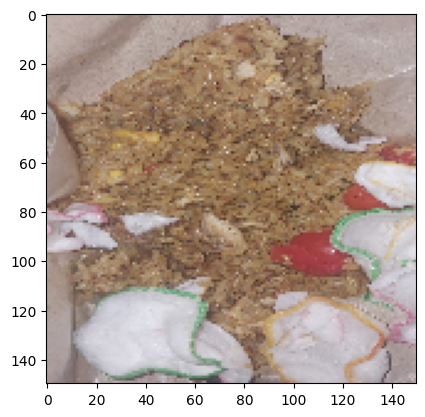


Image prediction result 1:  nasi_goreng   99.97479319572449 %

Image prediction result 2:  pizza   0.015034091484267265 %

Image prediction result 3:  bakwan   0.00802583308541216 %


1/1 [==============================] - 0s 37ms/step




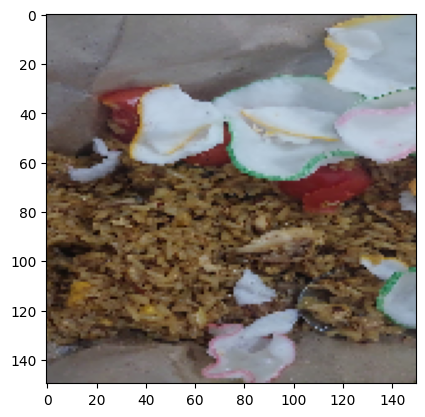


Image prediction result 1:  ice_cream   98.32202196121216 %

Image prediction result 2:  nasi_goreng   1.2679709121584892 %

Image prediction result 3:  ayam krispi   0.23820106871426105 %


1/1 [==============================] - 0s 36ms/step




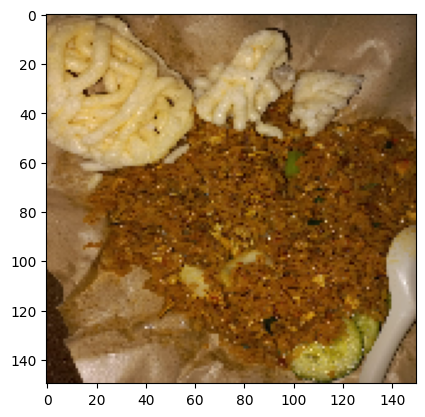


Image prediction result 1:  burger   79.40659523010254 %

Image prediction result 2:  nasi_goreng   18.110521137714386 %

Image prediction result 3:  kentang_goreng   1.0204792954027653 %


1/1 [==============================] - 0s 38ms/step




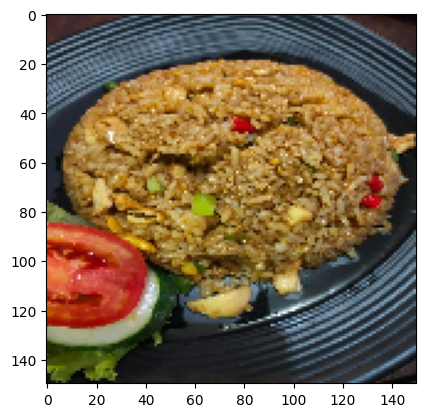


Image prediction result 1:  nasi_goreng   99.93829727172852 %

Image prediction result 2:  bakwan   0.061610282864421606 %

Image prediction result 3:  nasi_kuning   8.368945714209985e-05 %


1/1 [==============================] - 0s 50ms/step




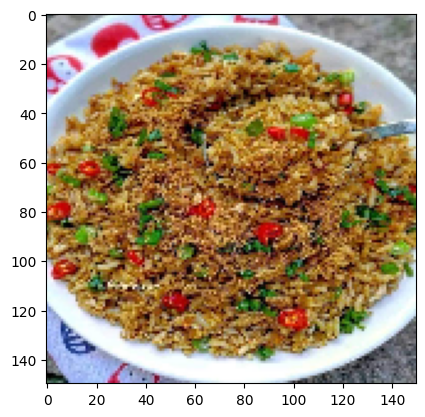


Image prediction result 1:  nasi_goreng   100.0 %

Image prediction result 2:  nasi_kuning   6.595867407810374e-07 %

Image prediction result 3:  ayam krispi   8.059094190604466e-10 %


1/1 [==============================] - 0s 24ms/step




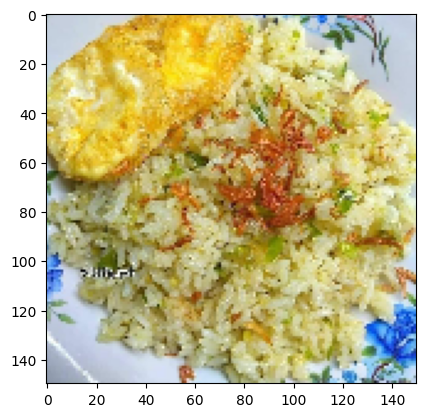


Image prediction result 1:  nasi_goreng   40.82957208156586 %

Image prediction result 2:  ayam krispi   40.21926820278168 %

Image prediction result 3:  bakwan   17.235124111175537 %


1/1 [==============================] - 0s 25ms/step




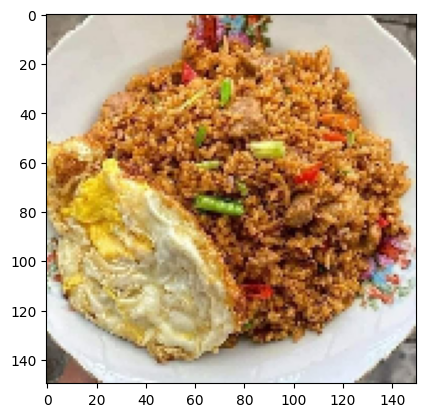


Image prediction result 1:  ikan   99.98981952667236 %

Image prediction result 2:  ayam krispi   0.0069476714998018 %

Image prediction result 3:  nasi_goreng   0.002693361420824658 %


1/1 [==============================] - 0s 28ms/step




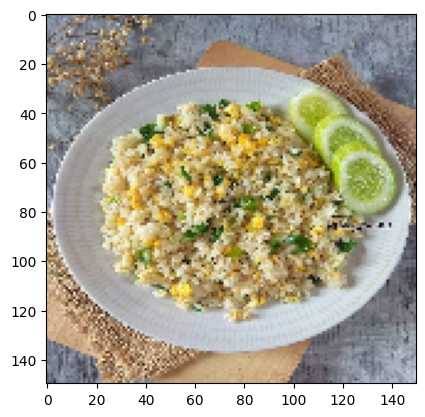


Image prediction result 1:  nasi_goreng   78.07751893997192 %

Image prediction result 2:  bakwan   11.888012290000916 %

Image prediction result 3:  nasi_kuning   7.965417206287384 %


1/1 [==============================] - 0s 28ms/step




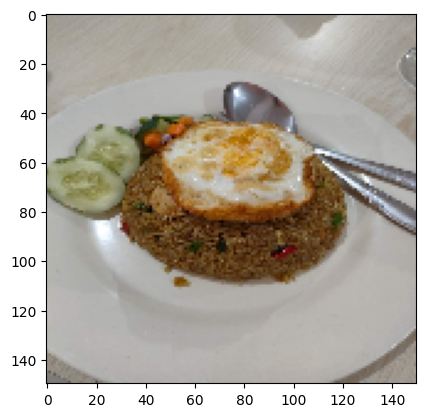


Image prediction result 1:  nasi_goreng   73.83893728256226 %

Image prediction result 2:  cheesecake   20.011019706726074 %

Image prediction result 3:  crepes   5.545170605182648 %


1/1 [==============================] - 0s 37ms/step




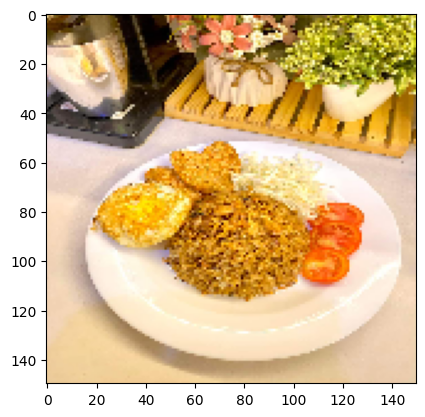


Image prediction result 1:  nasi_goreng   60.56392192840576 %

Image prediction result 2:  cheesecake   16.141164302825928 %

Image prediction result 3:  ayam krispi   13.93665075302124 %


1/1 [==============================] - 0s 34ms/step




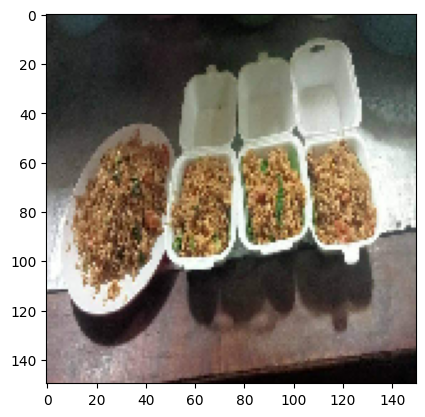


Image prediction result 1:  bakso   99.1212785243988 %

Image prediction result 2:  ice_cream   0.47958577051758766 %

Image prediction result 3:  ayam krispi   0.3972873091697693 %


1/1 [==============================] - 0s 35ms/step




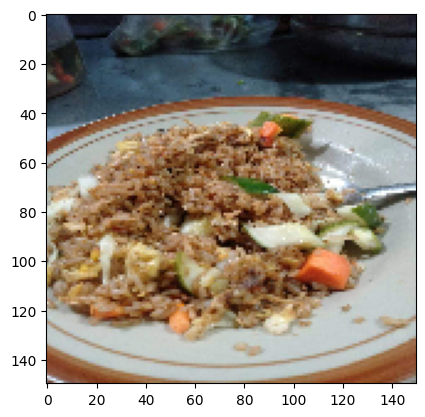


Image prediction result 1:  nasi_goreng   99.99994039535522 %

Image prediction result 2:  ayam krispi   6.0596880757657345e-05 %

Image prediction result 3:  bakso   5.80450931764176e-07 %


1/1 [==============================] - 0s 39ms/step




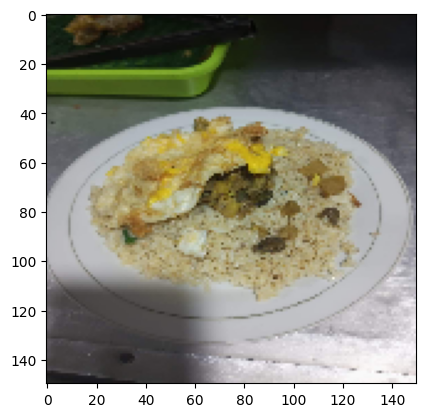


Image prediction result 1:  nasi_goreng   99.3747353553772 %

Image prediction result 2:  pizza   0.6160010118037462 %

Image prediction result 3:  burger   0.007730916695436463 %


1/1 [==============================] - 0s 33ms/step




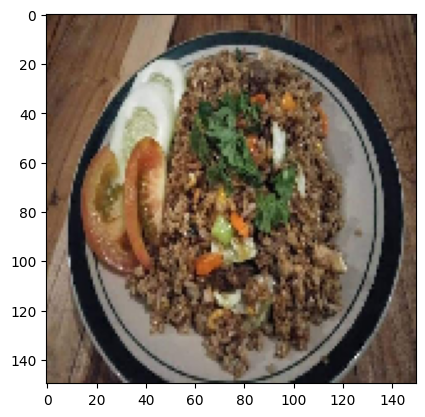


Image prediction result 1:  nasi_goreng   99.98055100440979 %

Image prediction result 2:  ayam krispi   0.016190073802135885 %

Image prediction result 3:  bakso   0.0032157655368791893 %


1/1 [==============================] - 0s 49ms/step




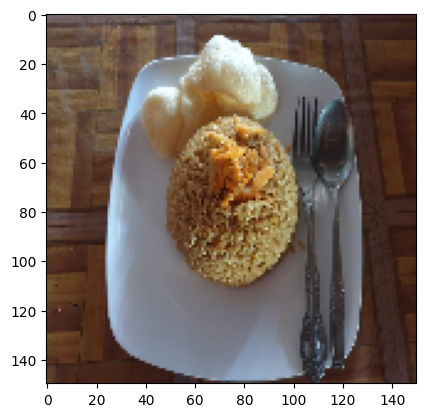


Image prediction result 1:  nasi_goreng   82.20816254615784 %

Image prediction result 2:  ice_cream   17.783646285533905 %

Image prediction result 3:  ayam krispi   0.007151842146413401 %


1/1 [==============================] - 0s 36ms/step




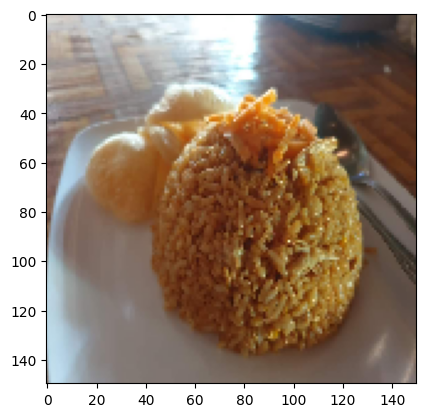


Image prediction result 1:  nasi_goreng   99.99814033508301 %

Image prediction result 2:  nasi_kuning   0.001686528958089184 %

Image prediction result 3:  cheesecake   8.35430341794563e-05 %


1/1 [==============================] - 0s 34ms/step




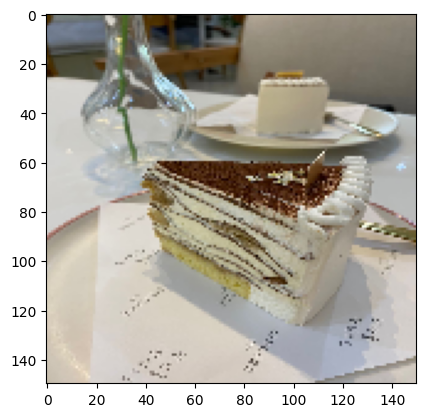


Image prediction result 1:  cheesecake   100.0 %

Image prediction result 2:  ice_cream   2.3405085869399045e-06 %

Image prediction result 3:  kentang_goreng   4.7613541391934924e-12 %


1/1 [==============================] - 0s 52ms/step




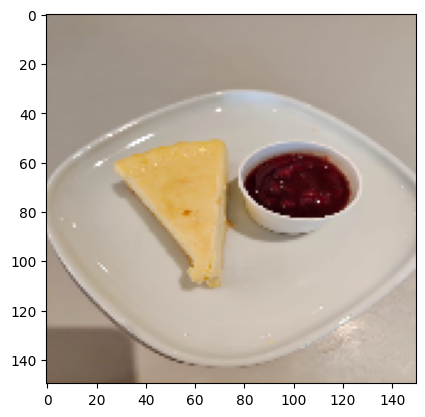


Image prediction result 1:  cheesecake   91.9835090637207 %

Image prediction result 2:  ice_cream   7.608756422996521 %

Image prediction result 3:  kentang_goreng   0.2546057105064392 %


1/1 [==============================] - 0s 34ms/step




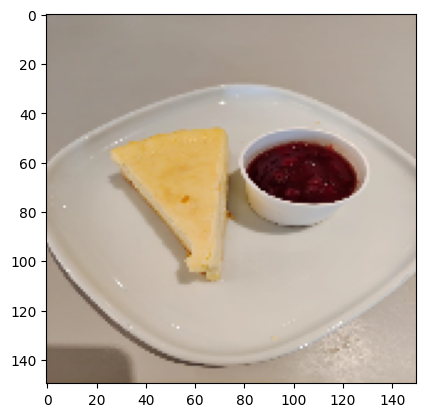


Image prediction result 1:  cheesecake   99.74664449691772 %

Image prediction result 2:  ice_cream   0.2532804850488901 %

Image prediction result 3:  kentang_goreng   7.311139711418946e-05 %


1/1 [==============================] - 0s 35ms/step




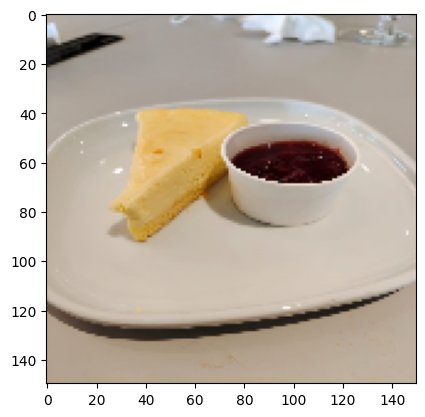


Image prediction result 1:  cheesecake   100.0 %

Image prediction result 2:  kentang_goreng   1.828980966678273e-07 %

Image prediction result 3:  ice_cream   1.8685358815773156e-08 %


1/1 [==============================] - 0s 35ms/step




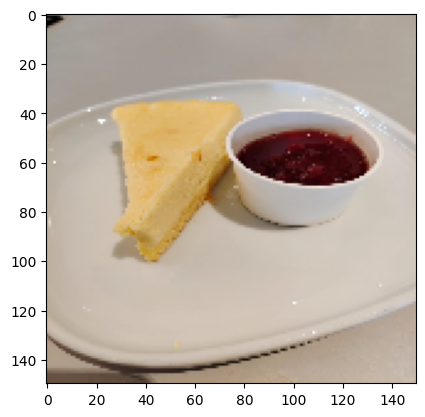


Image prediction result 1:  cheesecake   99.99847412109375 %

Image prediction result 2:  ice_cream   0.0015292471289285459 %

Image prediction result 3:  kentang_goreng   1.2503791947150733e-11 %


1/1 [==============================] - 0s 37ms/step




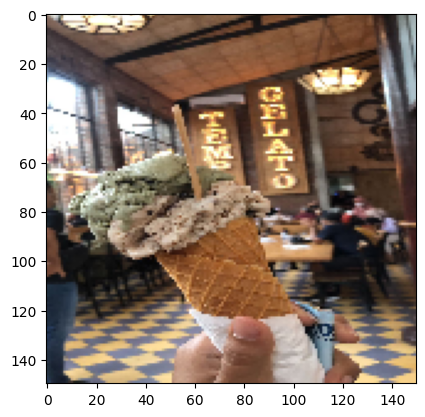


Image prediction result 1:  bakso   99.99898672103882 %

Image prediction result 2:  ice_cream   0.0010112693416886032 %

Image prediction result 3:  ayam krispi   5.504442235348961e-07 %


1/1 [==============================] - 0s 38ms/step




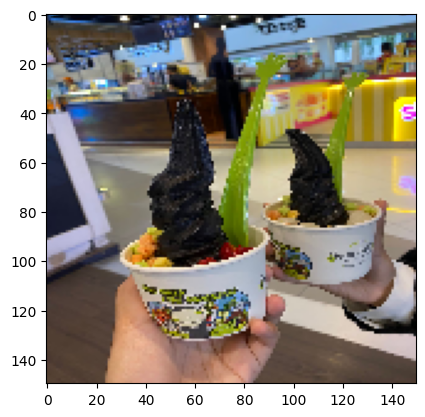


Image prediction result 1:  ice_cream   99.97135996818542 %

Image prediction result 2:  Donut   0.02201335009885952 %

Image prediction result 3:  cheesecake   0.005395426705945283 %


1/1 [==============================] - 0s 35ms/step




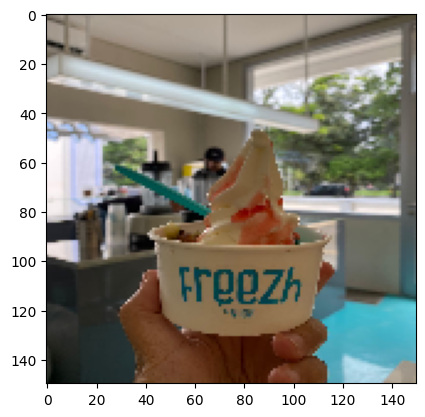


Image prediction result 1:  ice_cream   99.99969005584717 %

Image prediction result 2:  kentang_goreng   0.0003051451130886562 %

Image prediction result 3:  pizza   5.935962477110479e-06 %


1/1 [==============================] - 0s 34ms/step




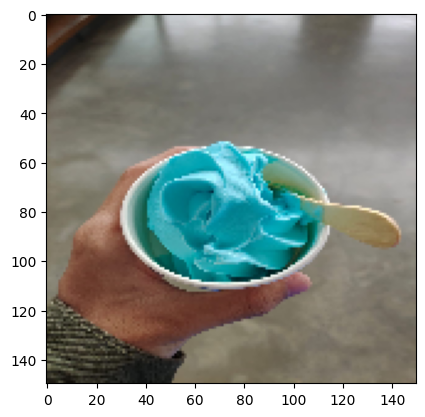


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  kentang_goreng   4.196286695901108e-06 %

Image prediction result 3:  bakso   7.920628129071128e-11 %


1/1 [==============================] - 0s 38ms/step




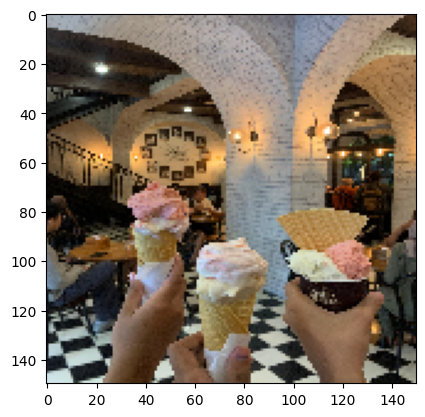


Image prediction result 1:  ice_cream   99.99997615814209 %

Image prediction result 2:  pizza   1.5355934124272608e-05 %

Image prediction result 3:  bakso   7.09425478362391e-06 %


1/1 [==============================] - 0s 61ms/step




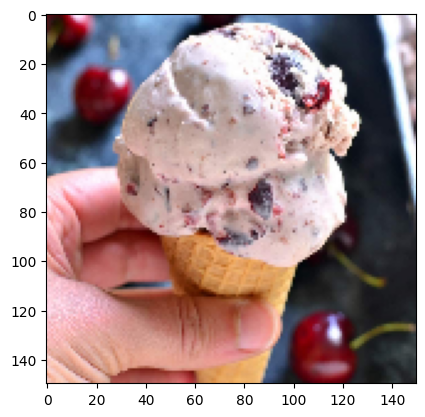


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  Donut   4.352851065703156e-09 %

Image prediction result 3:  kebab   1.1454396052533802e-12 %


1/1 [==============================] - 0s 34ms/step




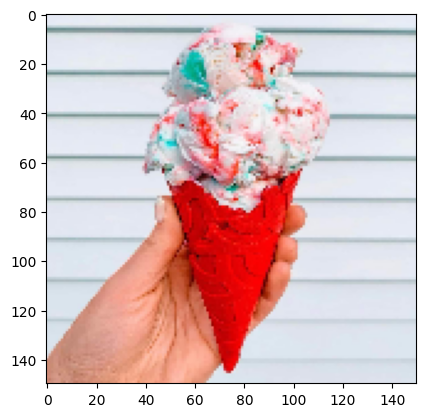


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  ayam krispi   2.789562504601495e-09 %

Image prediction result 3:  kentang_goreng   6.017814014030315e-12 %


1/1 [==============================] - 0s 37ms/step




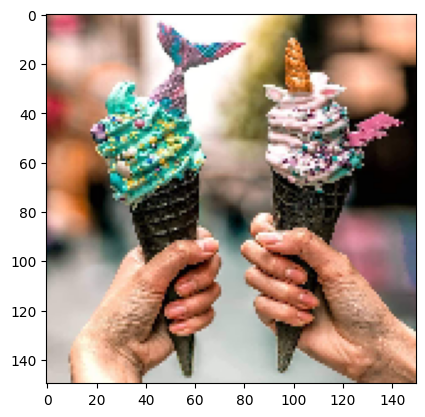


Image prediction result 1:  Donut   99.98157620429993 %

Image prediction result 2:  burger   0.014820773503743112 %

Image prediction result 3:  kentang_goreng   0.0022391048332792707 %


1/1 [==============================] - 0s 76ms/step




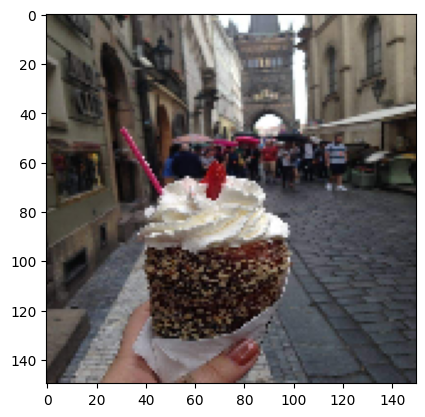


Image prediction result 1:  ice_cream   99.99998807907104 %

Image prediction result 2:  bakso   1.4336477249798918e-05 %

Image prediction result 3:  nasi_goreng   6.146335440604389e-07 %


1/1 [==============================] - 0s 36ms/step




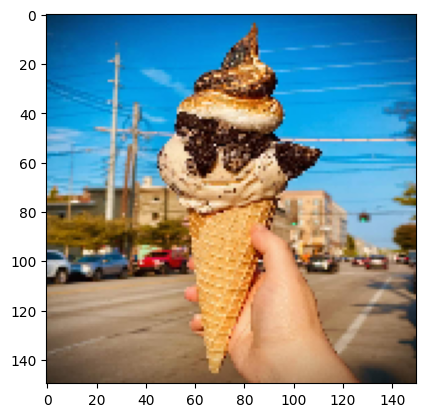


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  cheesecake   4.9124959877961186e-12 %

Image prediction result 3:  Donut   8.921237297618463e-13 %


1/1 [==============================] - 0s 34ms/step




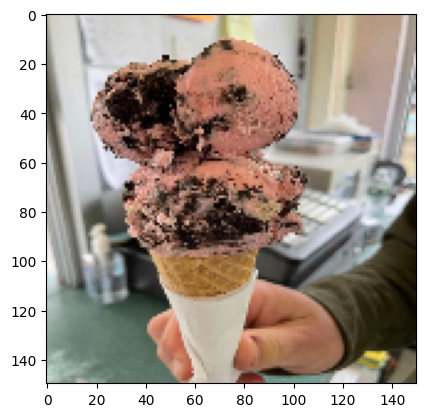


Image prediction result 1:  ice_cream   99.90990161895752 %

Image prediction result 2:  burger   0.0900446146260947 %

Image prediction result 3:  kebab   6.088880581955891e-05 %


1/1 [==============================] - 0s 34ms/step




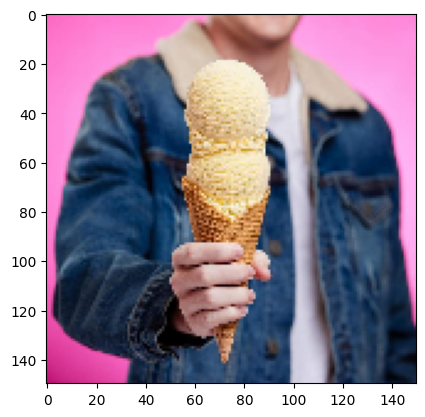


Image prediction result 1:  ice_cream   99.99998807907104 %

Image prediction result 2:  burger   1.0042740683502416e-05 %

Image prediction result 3:  kentang_goreng   2.976933207322202e-11 %


1/1 [==============================] - 0s 37ms/step




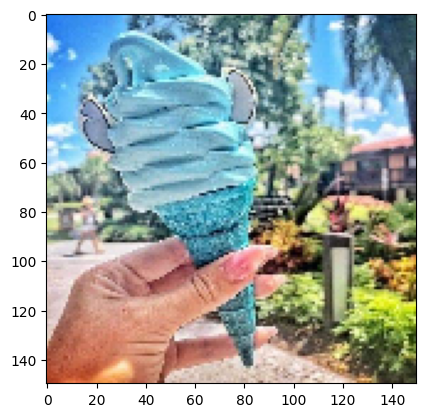


Image prediction result 1:  ice_cream   99.99946355819702 %

Image prediction result 2:  ayam krispi   0.00025135759642580524 %

Image prediction result 3:  Donut   9.944452585841645e-05 %


1/1 [==============================] - 0s 35ms/step




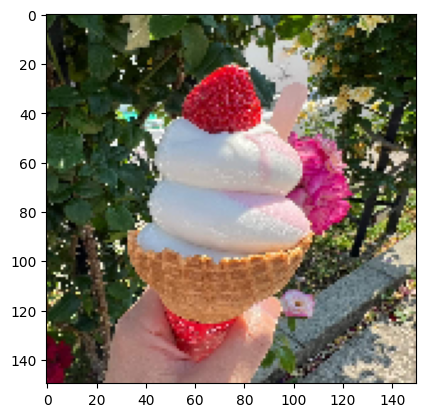


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  burger   2.656048991855897e-08 %

Image prediction result 3:  cheesecake   2.402112536659118e-09 %


1/1 [==============================] - 0s 40ms/step




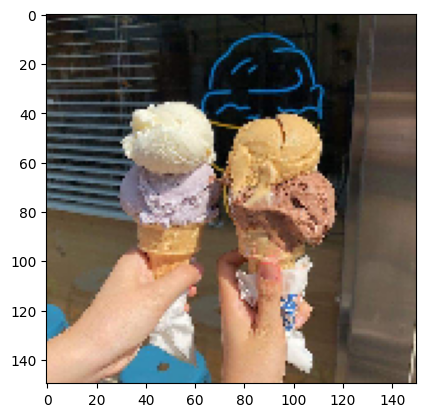


Image prediction result 1:  ice_cream   99.99998807907104 %

Image prediction result 2:  ayam krispi   5.361729549235861e-06 %

Image prediction result 3:  burger   3.2310815356595413e-06 %


1/1 [==============================] - 0s 34ms/step




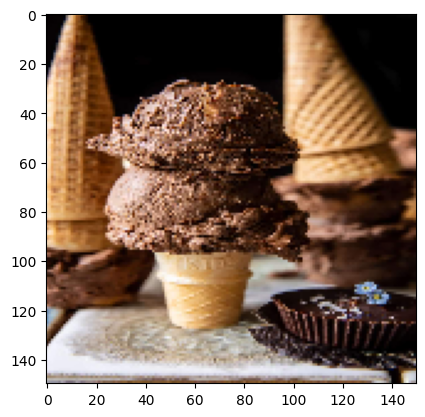


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  cheesecake   1.0151338103447927e-09 %

Image prediction result 3:  nasi_goreng   1.499680371205847e-10 %


1/1 [==============================] - 0s 35ms/step




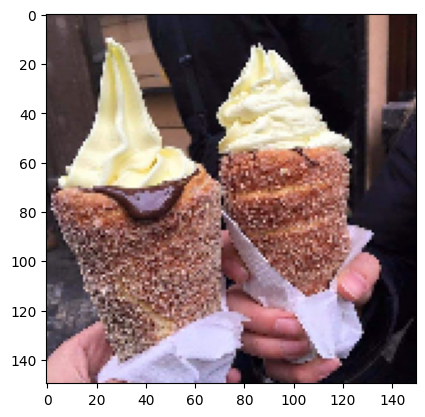


Image prediction result 1:  ice_cream   100.0 %

Image prediction result 2:  cheesecake   1.8023785131049408e-06 %

Image prediction result 3:  pizza   1.0932646787864542e-06 %


1/1 [==============================] - 0s 36ms/step




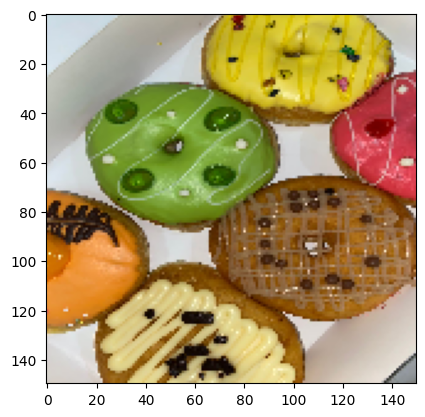


Image prediction result 1:  pizza   81.74859285354614 %

Image prediction result 2:  Donut   15.012533962726593 %

Image prediction result 3:  burger   3.234820067882538 %


1/1 [==============================] - 0s 59ms/step




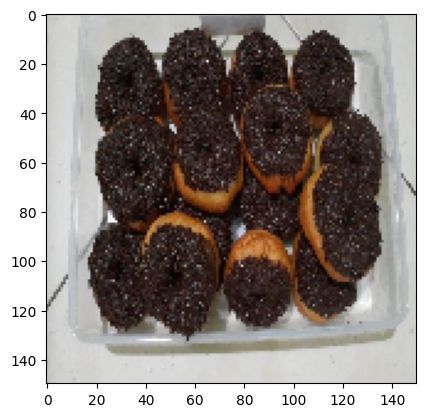


Image prediction result 1:  cheesecake   94.0942108631134 %

Image prediction result 2:  Donut   5.887925252318382 %

Image prediction result 3:  ice_cream   0.01656322565395385 %


1/1 [==============================] - 0s 40ms/step




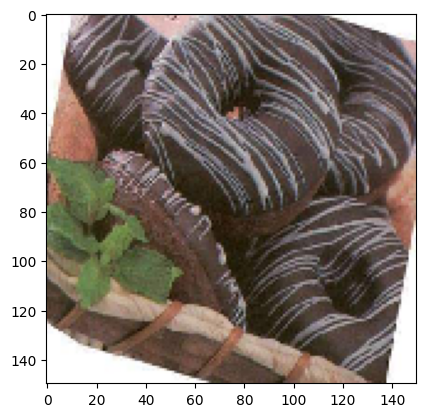


Image prediction result 1:  ice_cream   98.79246950149536 %

Image prediction result 2:  Donut   1.206345297396183 %

Image prediction result 3:  pizza   0.0005260864327283343 %


1/1 [==============================] - 0s 56ms/step




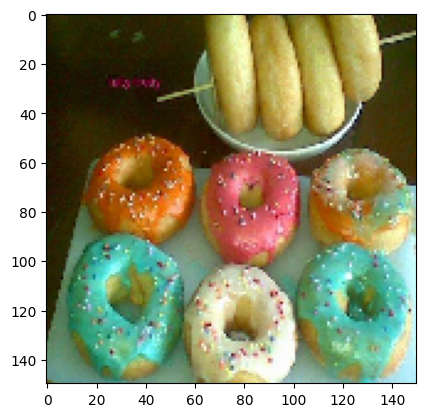


Image prediction result 1:  Apple   100.0 %

Image prediction result 2:  Donut   1.32296129606857e-06 %

Image prediction result 3:  anggur   2.821085921290989e-11 %


1/1 [==============================] - 0s 68ms/step




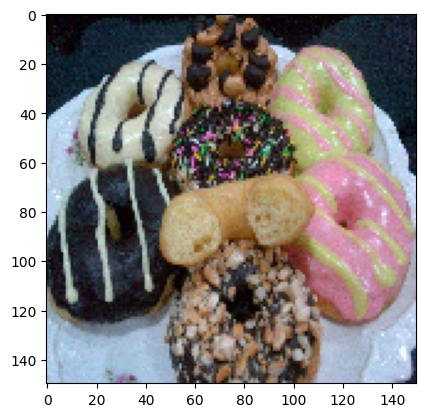


Image prediction result 1:  Donut   99.99077320098877 %

Image prediction result 2:  ice_cream   0.009165715164272115 %

Image prediction result 3:  ayam krispi   4.721593995782314e-05 %


1/1 [==============================] - 0s 35ms/step




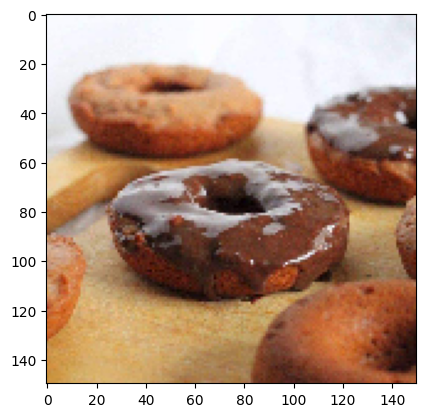


Image prediction result 1:  Donut   99.9998688697815 %

Image prediction result 2:  pizza   0.00013678230743607855 %

Image prediction result 3:  cheesecake   1.0635541752845867e-08 %


1/1 [==============================] - 0s 37ms/step




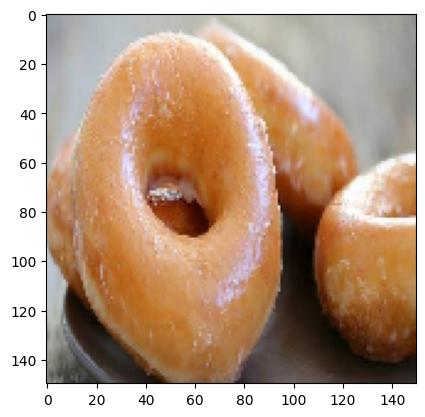


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  Apple   6.617032137298557e-16 %

Image prediction result 3:  cheesecake   1.4852657716061655e-24 %


1/1 [==============================] - 0s 34ms/step




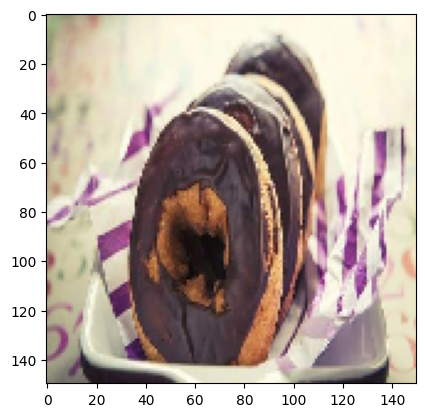


Image prediction result 1:  kebab   99.99687671661377 %

Image prediction result 2:  Apple   0.0028634231057367288 %

Image prediction result 3:  ice_cream   0.00026120428628928494 %


1/1 [==============================] - 0s 36ms/step




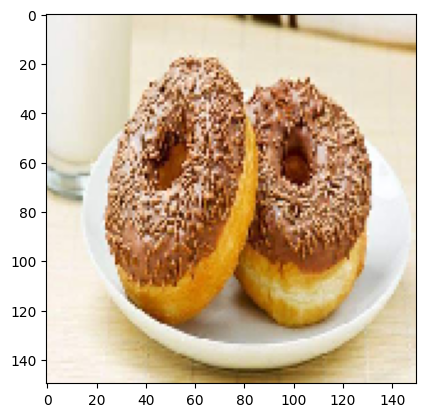


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  cheesecake   4.3657090570556404e-15 %

Image prediction result 3:  burger   2.9770637218644842e-15 %


1/1 [==============================] - 0s 33ms/step




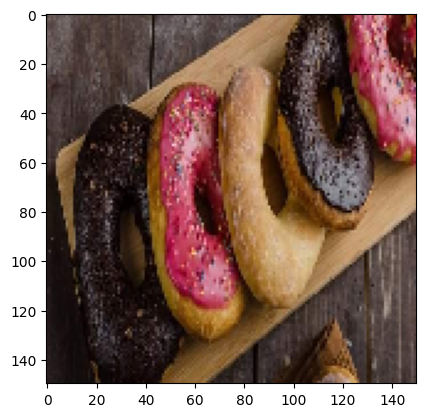


Image prediction result 1:  Donut   96.91104292869568 %

Image prediction result 2:  kebab   2.2108960896730423 %

Image prediction result 3:  burger   0.42319493368268013 %


1/1 [==============================] - 0s 38ms/step




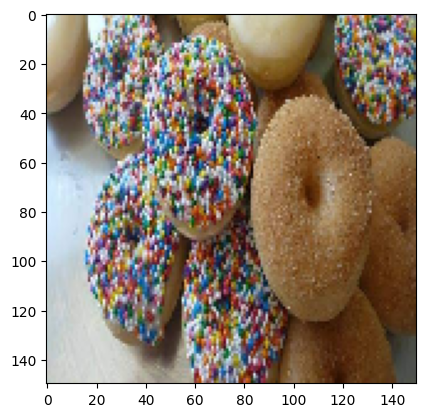


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  bakso   2.0321999562745302e-11 %

Image prediction result 3:  ice_cream   1.2501311834681172e-11 %


1/1 [==============================] - 0s 33ms/step




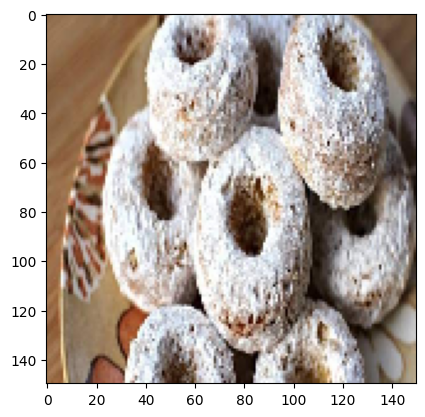


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  bakso   1.9799012429544405e-08 %

Image prediction result 3:  burger   2.5615826734076697e-11 %


1/1 [==============================] - 0s 40ms/step




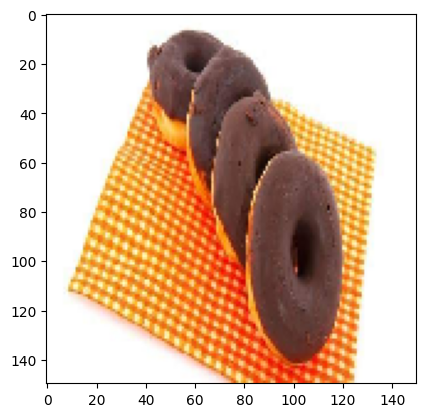


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  ice_cream   1.2081450284640027e-07 %

Image prediction result 3:  cheesecake   5.702615012555213e-13 %


1/1 [==============================] - 0s 33ms/step




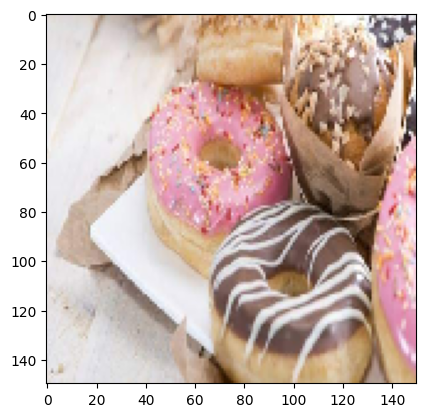


Image prediction result 1:  Donut   90.84646105766296 %

Image prediction result 2:  ice_cream   9.149225056171417 %

Image prediction result 3:  ayam krispi   0.0032375934097217396 %


1/1 [==============================] - 0s 49ms/step




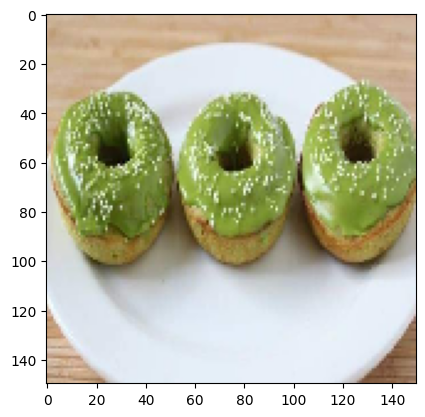


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  burger   3.412550461396463e-11 %

Image prediction result 3:  cheesecake   2.3377632295262796e-11 %


1/1 [==============================] - 0s 55ms/step




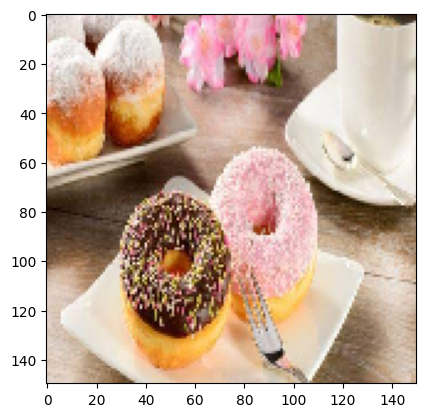


Image prediction result 1:  Donut   99.76267218589783 %

Image prediction result 2:  ice_cream   0.23732776753604412 %

Image prediction result 3:  nasi_goreng   2.7743682351477617e-08 %


1/1 [==============================] - 0s 56ms/step




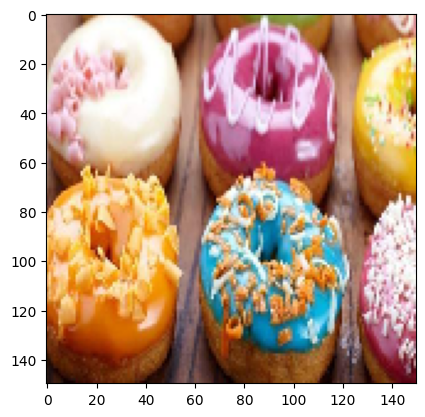


Image prediction result 1:  Donut   99.99802112579346 %

Image prediction result 2:  ice_cream   0.0017756285160430707 %

Image prediction result 3:  kentang_goreng   0.00020372042399685597 %


1/1 [==============================] - 0s 37ms/step




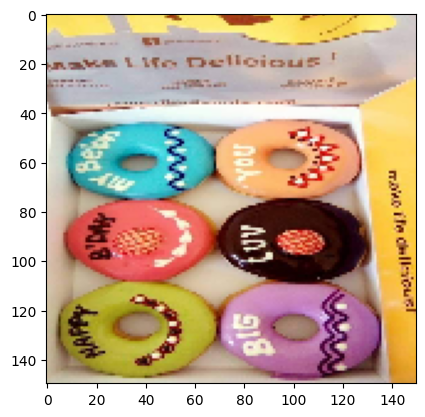


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  ice_cream   1.6005969336388426e-10 %

Image prediction result 3:  cheesecake   1.902225300087529e-13 %


1/1 [==============================] - 0s 38ms/step




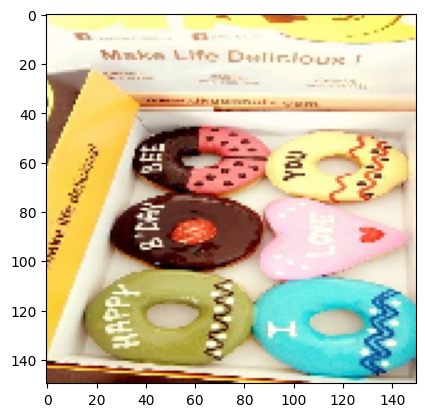


Image prediction result 1:  Donut   95.65001726150513 %

Image prediction result 2:  ice_cream   4.349357634782791 %

Image prediction result 3:  nasi_kuning   0.0006231770839804085 %


1/1 [==============================] - 0s 41ms/step




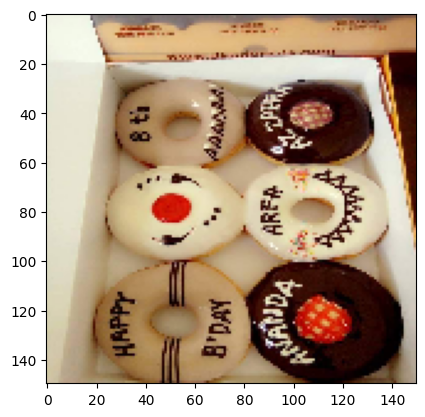


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  ice_cream   3.972600737256471e-06 %

Image prediction result 3:  cheesecake   2.8573429844414022e-06 %


1/1 [==============================] - 0s 35ms/step




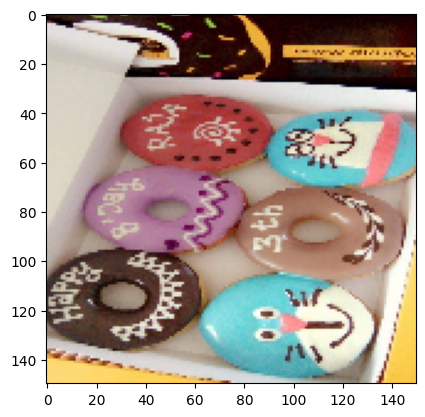


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  ice_cream   8.7014976387495e-11 %

Image prediction result 3:  burger   2.941084333539512e-11 %


1/1 [==============================] - 0s 37ms/step




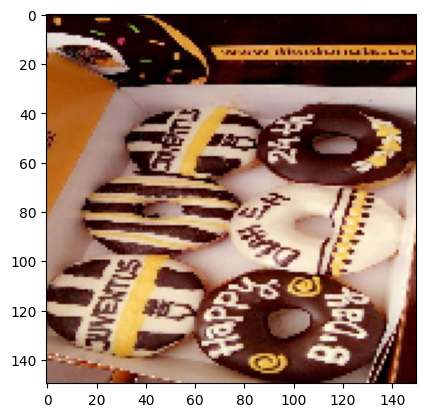


Image prediction result 1:  Donut   98.4718382358551 %

Image prediction result 2:  cheesecake   0.6112430244684219 %

Image prediction result 3:  ice_cream   0.4878760315477848 %


1/1 [==============================] - 0s 35ms/step




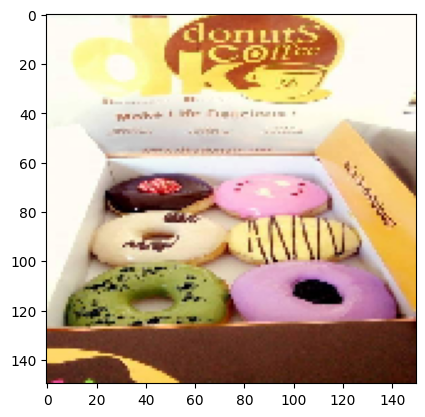


Image prediction result 1:  Donut   99.99830722808838 %

Image prediction result 2:  kebab   0.001082214748748811 %

Image prediction result 3:  ice_cream   0.00040215422814071644 %


1/1 [==============================] - 0s 38ms/step




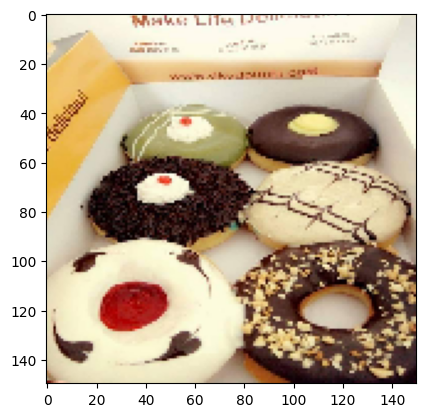


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  cheesecake   3.8572234295486396e-08 %

Image prediction result 3:  ice_cream   4.808765538544257e-09 %


1/1 [==============================] - 0s 36ms/step




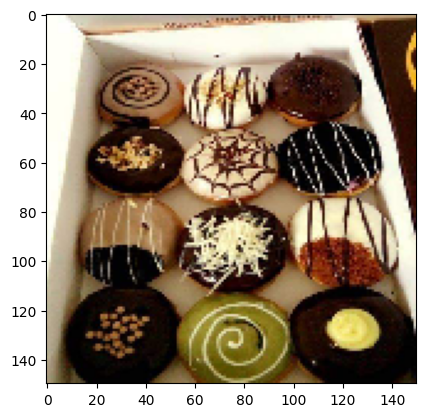


Image prediction result 1:  Donut   99.99880790710449 %

Image prediction result 2:  cheesecake   0.0011187905329279602 %

Image prediction result 3:  ice_cream   3.6697409200314723e-05 %


1/1 [==============================] - 0s 35ms/step




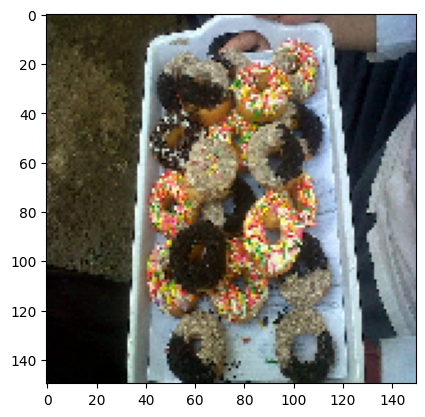


Image prediction result 1:  ice_cream   92.6976203918457 %

Image prediction result 2:  nasi_goreng   2.7618052437901497 %

Image prediction result 3:  pizza   2.4130096659064293 %


1/1 [==============================] - 0s 42ms/step




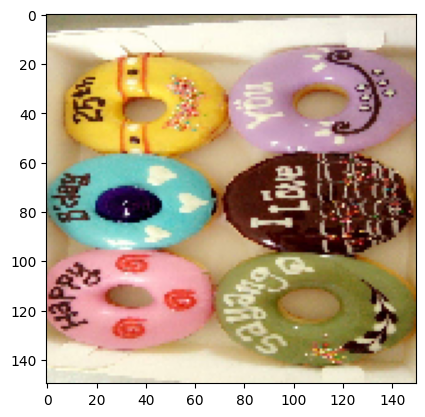


Image prediction result 1:  Donut   99.99998807907104 %

Image prediction result 2:  Apple   1.026522227220994e-05 %

Image prediction result 3:  pizza   1.0324073540513012e-08 %


1/1 [==============================] - 0s 39ms/step




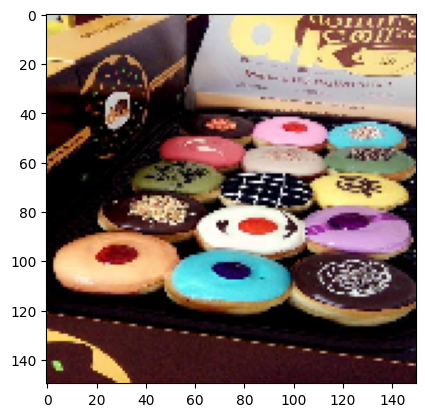


Image prediction result 1:  Donut   100.0 %

Image prediction result 2:  cheesecake   1.0422208929217192e-08 %

Image prediction result 3:  burger   6.871255300855417e-10 %


1/1 [==============================] - 0s 56ms/step




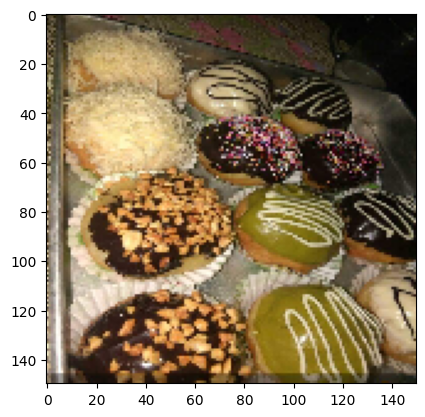


Image prediction result 1:  pizza   99.71150159835815 %

Image prediction result 2:  cheesecake   0.19714341033250093 %

Image prediction result 3:  Donut   0.08406633278355002 %


1/1 [==============================] - 0s 70ms/step




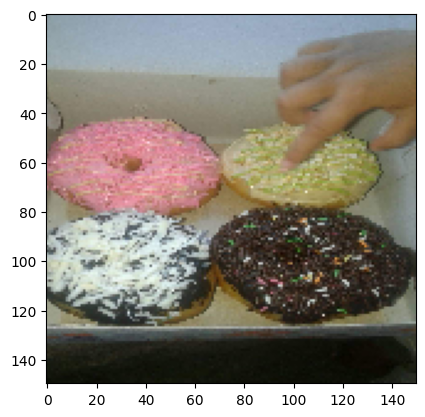


Image prediction result 1:  Donut   87.95400261878967 %

Image prediction result 2:  cheesecake   8.427819609642029 %

Image prediction result 3:  burger   3.6181293427944183 %


1/1 [==============================] - 0s 77ms/step




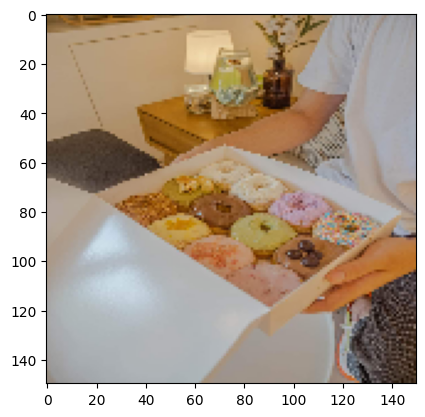


Image prediction result 1:  Donut   58.5665225982666 %

Image prediction result 2:  pizza   39.9120956659317 %

Image prediction result 3:  nasi_goreng   1.5126336365938187 %


1/1 [==============================] - 0s 34ms/step




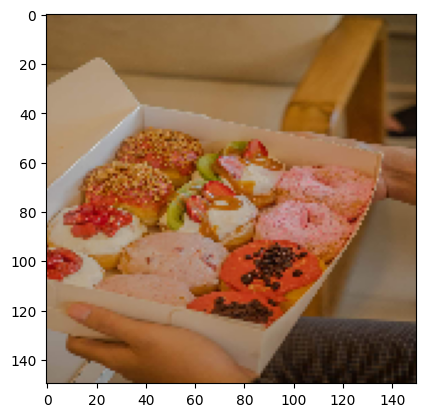


Image prediction result 1:  pizza   62.91639804840088 %

Image prediction result 2:  burger   37.05895245075226 %

Image prediction result 3:  ayam krispi   0.014063555863685906 %


1/1 [==============================] - 0s 37ms/step




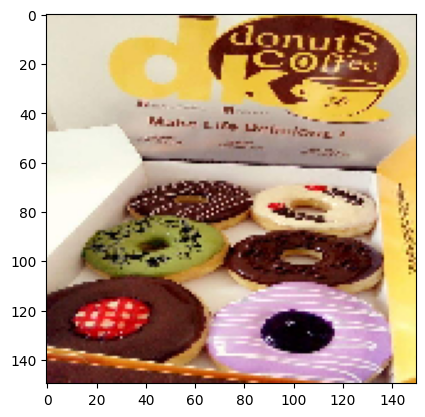


Image prediction result 1:  Donut   99.99876022338867 %

Image prediction result 2:  burger   0.0006610228865611134 %

Image prediction result 3:  cheesecake   0.0005462373792397557 %


1/1 [==============================] - 0s 36ms/step




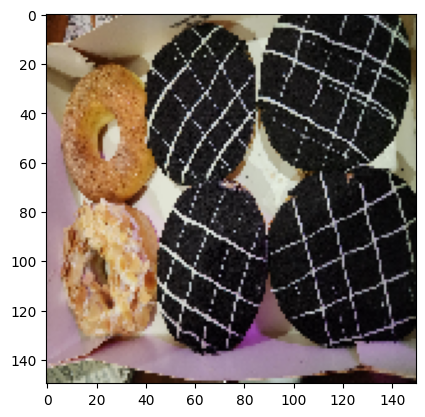


Image prediction result 1:  Donut   99.729984998703 %

Image prediction result 2:  pizza   0.2575403079390526 %

Image prediction result 3:  cheesecake   0.01232494687428698 %


1/1 [==============================] - 0s 36ms/step




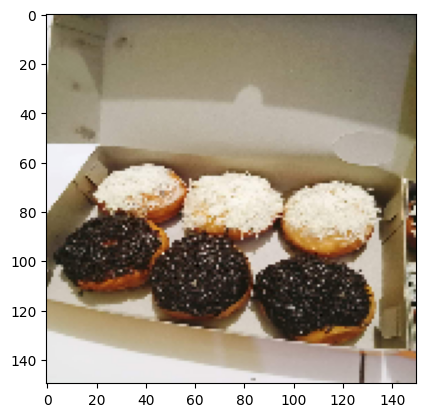


Image prediction result 1:  Donut   95.96556425094604 %

Image prediction result 2:  cheesecake   4.034413769841194 %

Image prediction result 3:  bakso   1.8626298015078646e-05 %


1/1 [==============================] - 0s 34ms/step




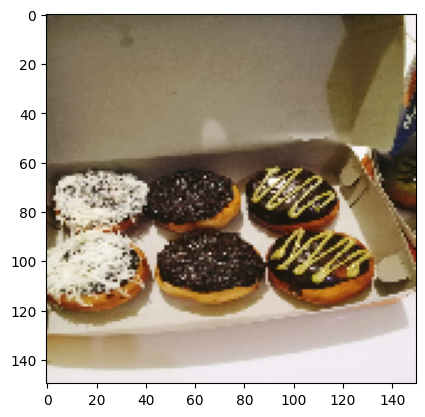


Image prediction result 1:  Donut   99.9991774559021 %

Image prediction result 2:  cheesecake   0.0008240164788730908 %

Image prediction result 3:  ice_cream   4.084186855379812e-06 %


1/1 [==============================] - 0s 36ms/step




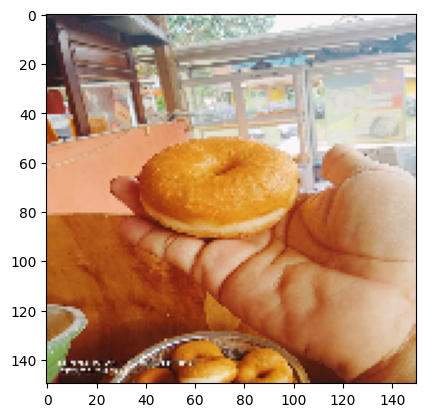


Image prediction result 1:  ice_cream   54.80823516845703 %

Image prediction result 2:  Apple   42.76031851768494 %

Image prediction result 3:  kentang_goreng   2.4175308644771576 %


1/1 [==============================] - 0s 38ms/step




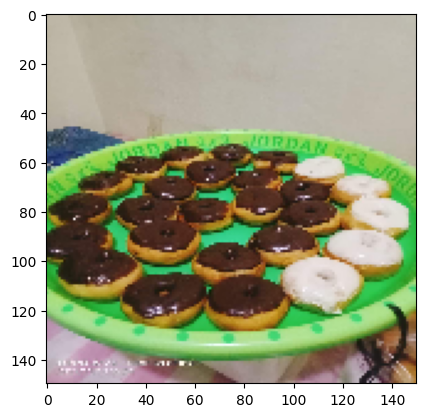


Image prediction result 1:  cheesecake   99.99921321868896 %

Image prediction result 2:  Donut   0.000696628785590292 %

Image prediction result 3:  pizza   9.642882332627778e-05 %


1/1 [==============================] - 0s 41ms/step




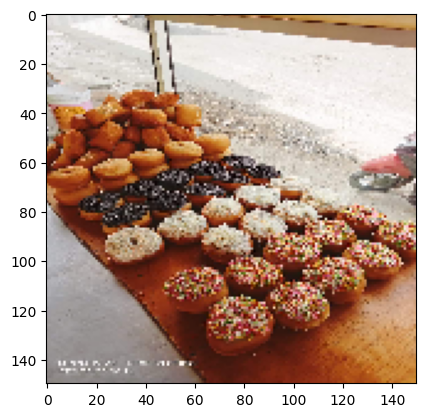


Image prediction result 1:  Donut   99.99916553497314 %

Image prediction result 2:  anggur   0.0008303271897602826 %

Image prediction result 3:  cheesecake   5.695882307477085e-09 %


1/1 [==============================] - 0s 38ms/step




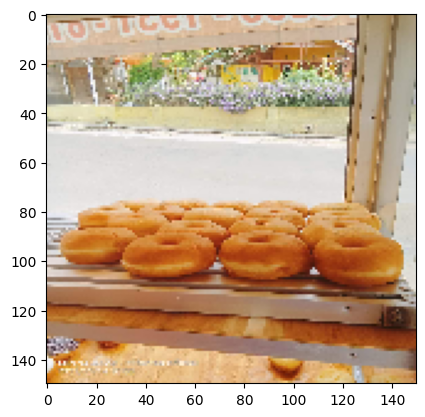


Image prediction result 1:  Donut   99.99998807907104 %

Image prediction result 2:  cheesecake   6.092717086403354e-06 %

Image prediction result 3:  ice_cream   9.181549964765168e-08 %


1/1 [==============================] - 0s 34ms/step




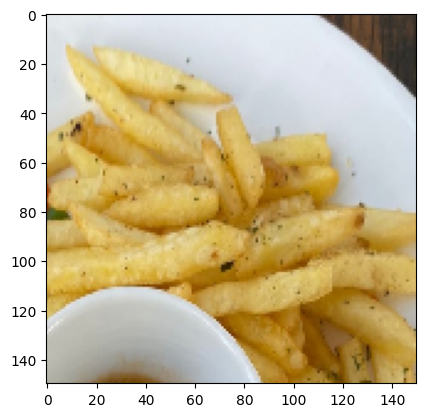


Image prediction result 1:  kentang_goreng   100.0 %

Image prediction result 2:  ayam krispi   5.69245484083325e-09 %

Image prediction result 3:  bakso   8.928591237666525e-13 %


1/1 [==============================] - 0s 34ms/step




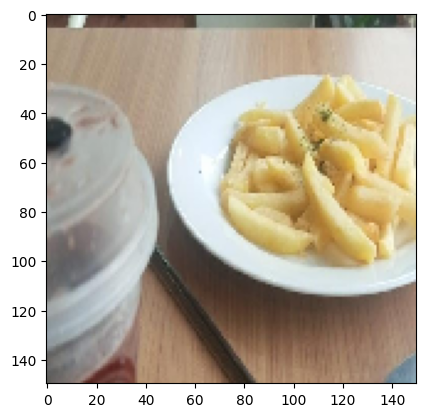


Image prediction result 1:  kentang_goreng   100.0 %

Image prediction result 2:  burger   5.088859455354422e-10 %

Image prediction result 3:  ice_cream   8.430720179050319e-12 %


1/1 [==============================] - 0s 37ms/step




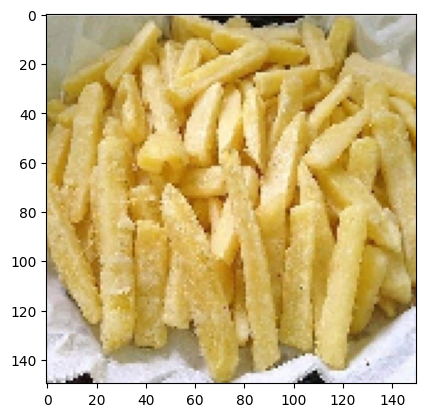


Image prediction result 1:  kentang_goreng   100.0 %

Image prediction result 2:  ayam krispi   1.0392635640954495e-07 %

Image prediction result 3:  burger   1.6861360398190417e-10 %


1/1 [==============================] - 0s 34ms/step




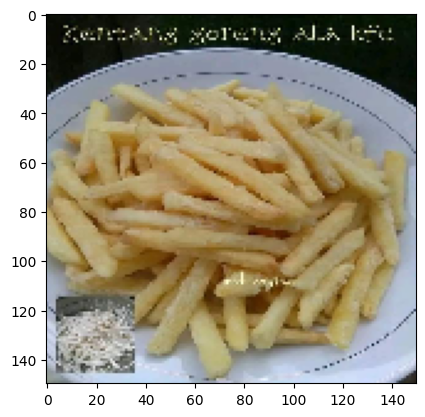


Image prediction result 1:  kentang_goreng   100.0 %

Image prediction result 2:  crepes   4.4208262519396413e-16 %

Image prediction result 3:  ayam krispi   4.149561469039614e-16 %


1/1 [==============================] - 0s 34ms/step




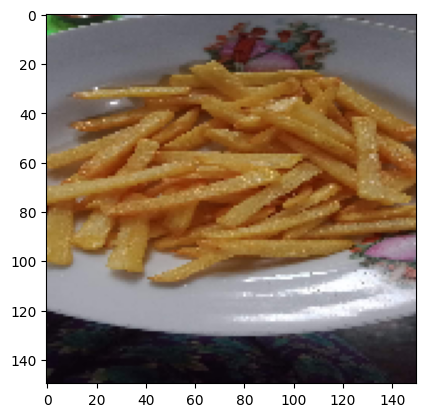


Image prediction result 1:  kentang_goreng   100.0 %

Image prediction result 2:  ayam krispi   2.5243580296538078e-14 %

Image prediction result 3:  nasi_goreng   1.3810168067484931e-18 %


1/1 [==============================] - 0s 59ms/step




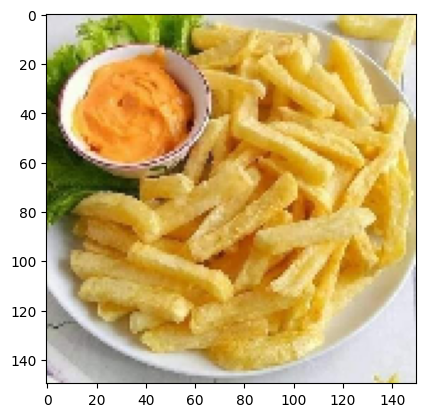


Image prediction result 1:  kentang_goreng   100.0 %

Image prediction result 2:  burger   1.2762239182118051e-10 %

Image prediction result 3:  ayam krispi   5.915482947232986e-12 %


1/1 [==============================] - 0s 58ms/step




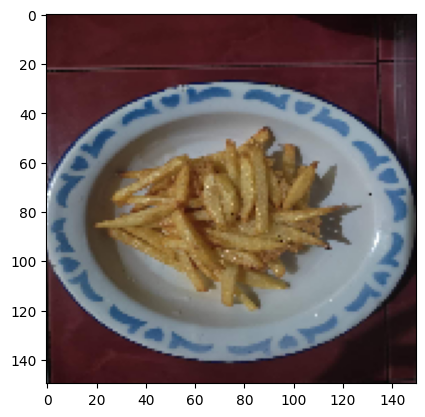


Image prediction result 1:  kentang_goreng   97.1710205078125 %

Image prediction result 2:  ayam krispi   2.82888300716877 %

Image prediction result 3:  bakwan   8.040447028179187e-05 %


1/1 [==============================] - 0s 34ms/step




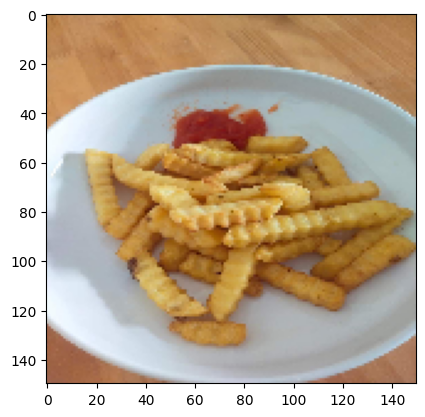


Image prediction result 1:  kentang_goreng   95.22690773010254 %

Image prediction result 2:  ayam krispi   4.772861301898956 %

Image prediction result 3:  ice_cream   0.00019298486222396605 %


1/1 [==============================] - 0s 34ms/step




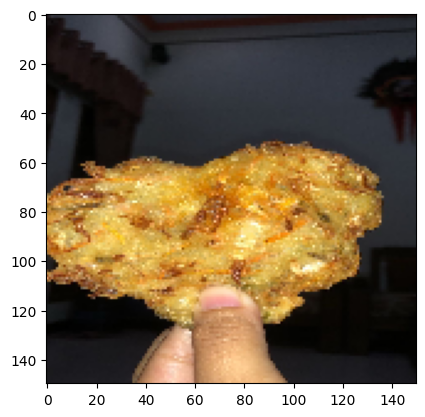


Image prediction result 1:  ayam krispi   84.66536402702332 %

Image prediction result 2:  nasi_goreng   10.104432702064514 %

Image prediction result 3:  nasi_kuning   3.0451247468590736 %


1/1 [==============================] - 0s 41ms/step




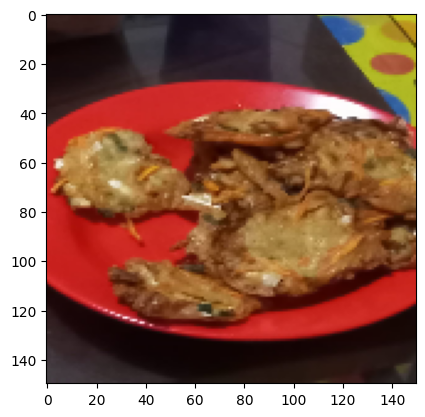


Image prediction result 1:  bakwan   90.42216539382935 %

Image prediction result 2:  bakso   7.320623099803925 %

Image prediction result 3:  ikan   2.2571904584765434 %


1/1 [==============================] - 0s 34ms/step




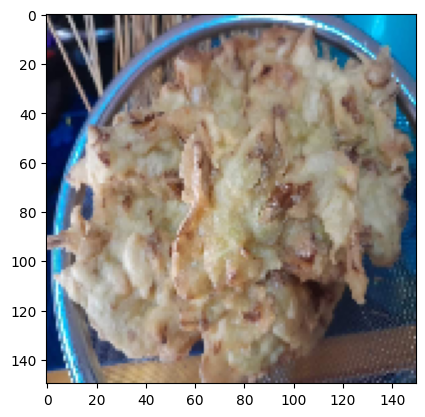


Image prediction result 1:  bakwan   58.03208947181702 %

Image prediction result 2:  nasi_goreng   41.967666149139404 %

Image prediction result 3:  pizza   0.00015232901660056086 %


1/1 [==============================] - 0s 36ms/step




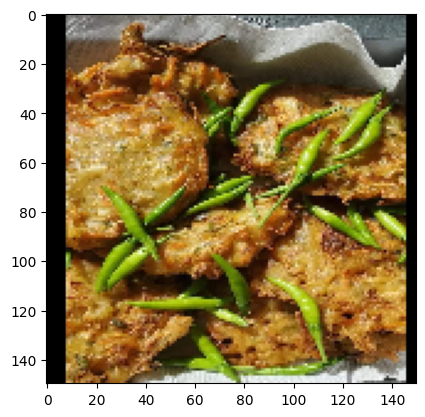


Image prediction result 1:  ayam krispi   99.48101043701172 %

Image prediction result 2:  pizza   0.24782223626971245 %

Image prediction result 3:  nasi_goreng   0.203052069991827 %


1/1 [==============================] - 0s 34ms/step




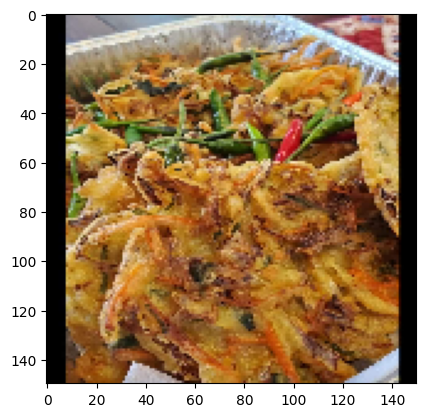


Image prediction result 1:  bakwan   64.71527814865112 %

Image prediction result 2:  pizza   30.56187331676483 %

Image prediction result 3:  ikan   1.815439946949482 %


1/1 [==============================] - 0s 44ms/step




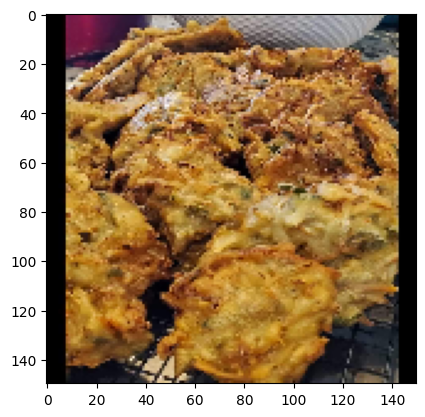


Image prediction result 1:  bakwan   57.98901319503784 %

Image prediction result 2:  ayam krispi   33.45511555671692 %

Image prediction result 3:  pizza   7.789262384176254 %


1/1 [==============================] - 0s 54ms/step




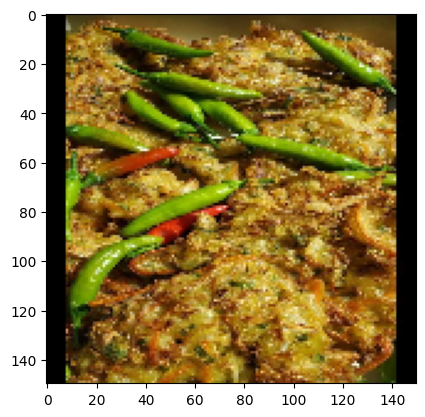


Image prediction result 1:  pizza   99.5141863822937 %

Image prediction result 2:  nasi_goreng   0.453413650393486 %

Image prediction result 3:  ayam krispi   0.02760907809715718 %


1/1 [==============================] - 0s 36ms/step




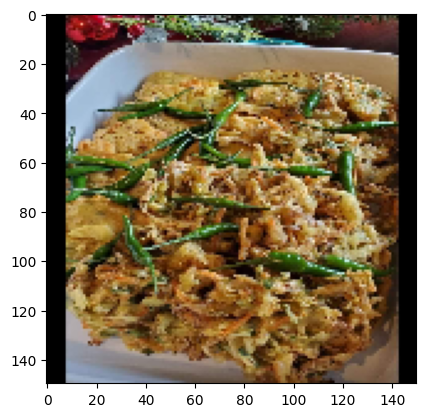


Image prediction result 1:  pizza   99.9948263168335 %

Image prediction result 2:  ayam krispi   0.002942560240626335 %

Image prediction result 3:  nasi_goreng   0.002171628875657916 %


1/1 [==============================] - 0s 48ms/step




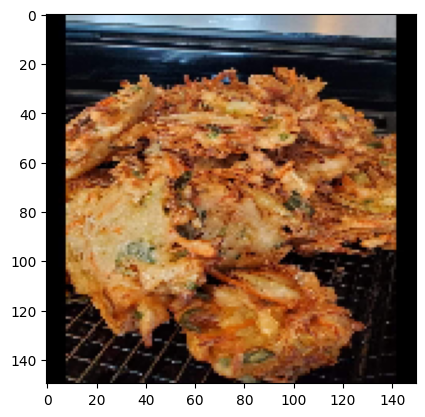


Image prediction result 1:  nasi_goreng   84.58980917930603 %

Image prediction result 2:  pizza   6.750904768705368 %

Image prediction result 3:  nasi_kuning   5.004002153873444 %


1/1 [==============================] - 0s 45ms/step




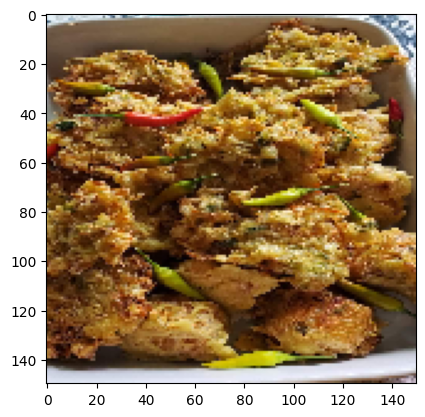


Image prediction result 1:  nasi_goreng   98.84145259857178 %

Image prediction result 2:  ayam krispi   1.1585120111703873 %

Image prediction result 3:  bakwan   3.048227483759547e-05 %


1/1 [==============================] - 0s 80ms/step




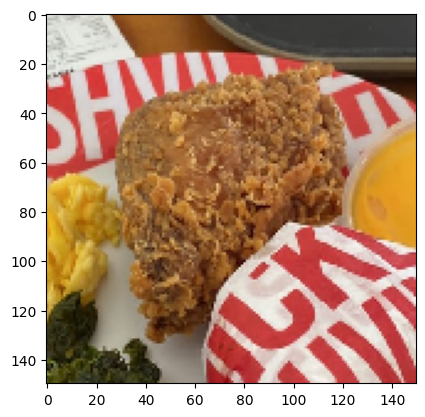


Image prediction result 1:  ayam krispi   98.28489422798157 %

Image prediction result 2:  nasi_goreng   1.0190492495894432 %

Image prediction result 3:  nasi_kuning   0.6842199712991714 %


1/1 [==============================] - 0s 69ms/step




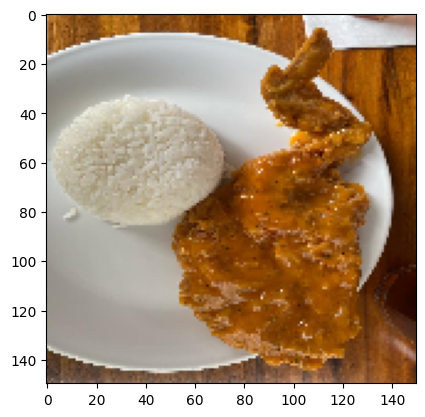


Image prediction result 1:  ice_cream   59.621208906173706 %

Image prediction result 2:  bakso   33.925554156303406 %

Image prediction result 3:  cheesecake   4.1534896939992905 %


1/1 [==============================] - 0s 37ms/step




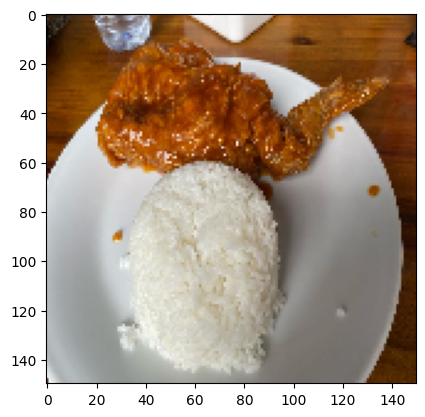


Image prediction result 1:  ayam krispi   99.98358488082886 %

Image prediction result 2:  cheesecake   0.0095814757514745 %

Image prediction result 3:  bakso   0.006744908750988543 %


1/1 [==============================] - 0s 55ms/step




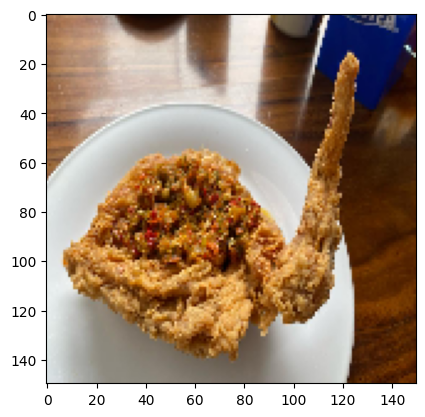


Image prediction result 1:  ayam krispi   98.35124611854553 %

Image prediction result 2:  nasi_goreng   1.6472352668642998 %

Image prediction result 3:  nasi_kuning   0.0014868965990899596 %


1/1 [==============================] - 0s 37ms/step




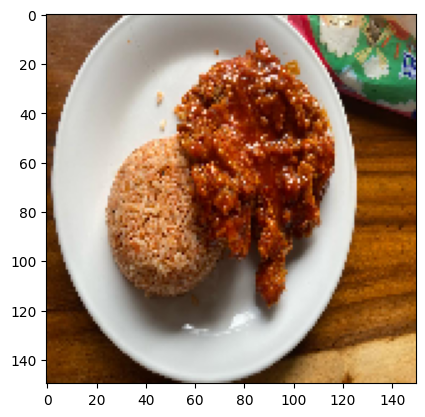


Image prediction result 1:  ayam krispi   99.99912977218628 %

Image prediction result 2:  bakso   0.0005107695869810414 %

Image prediction result 3:  pizza   0.00020758866412506904 %


1/1 [==============================] - 0s 35ms/step




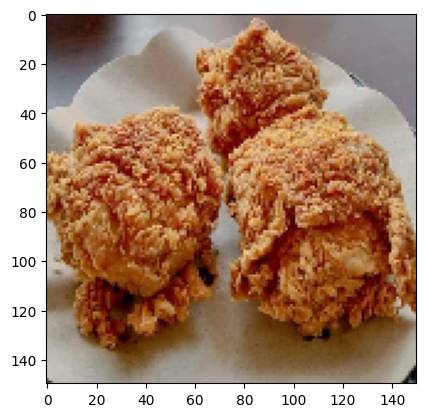


Image prediction result 1:  ayam krispi   99.92257356643677 %

Image prediction result 2:  ice_cream   0.07377126603387296 %

Image prediction result 3:  bakwan   0.003391552672837861 %


1/1 [==============================] - 0s 35ms/step




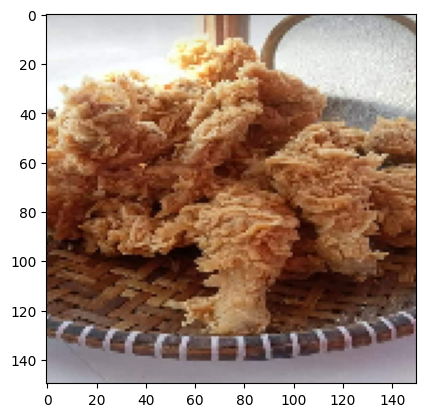


Image prediction result 1:  ayam krispi   99.99419450759888 %

Image prediction result 2:  bakwan   0.005800734652439132 %

Image prediction result 3:  nasi_goreng   7.35063732104635e-08 %


1/1 [==============================] - 0s 38ms/step




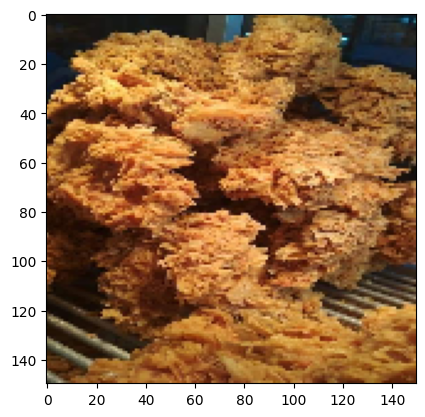


Image prediction result 1:  ayam krispi   99.99994039535522 %

Image prediction result 2:  nasi_goreng   5.638089533022139e-05 %

Image prediction result 3:  nasi_kuning   1.7005303831751917e-06 %


1/1 [==============================] - 0s 39ms/step




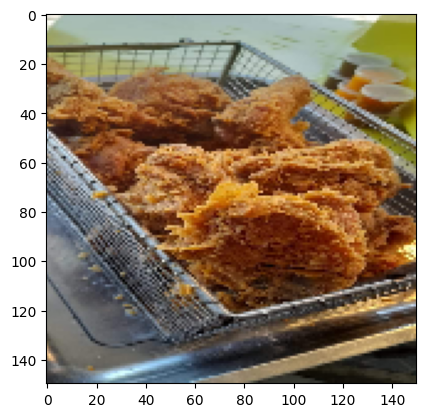


Image prediction result 1:  ayam krispi   100.0 %

Image prediction result 2:  bakwan   8.672779716611956e-08 %

Image prediction result 3:  ice_cream   1.5422309262991263e-08 %


1/1 [==============================] - 0s 39ms/step




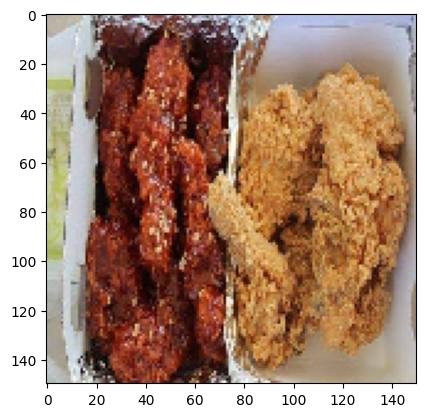


Image prediction result 1:  ayam krispi   99.60755705833435 %

Image prediction result 2:  bakso   0.3922080621123314 %

Image prediction result 3:  ikan   0.00020705363112938358 %


1/1 [==============================] - 0s 49ms/step




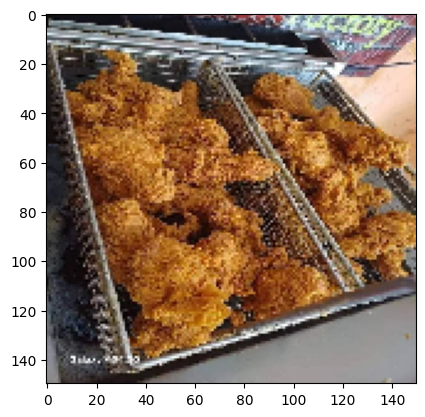


Image prediction result 1:  ice_cream   95.97532153129578 %

Image prediction result 2:  nasi_kuning   2.913367375731468 %

Image prediction result 3:  ayam krispi   1.0882805101573467 %


1/1 [==============================] - 0s 64ms/step




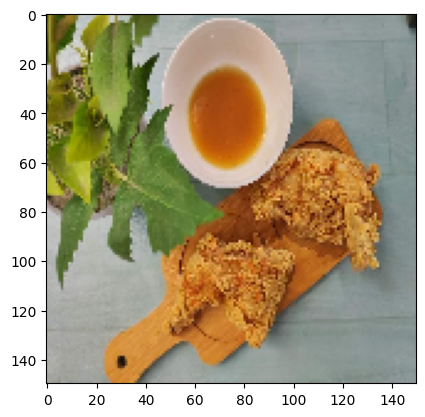


Image prediction result 1:  bakwan   91.11291766166687 %

Image prediction result 2:  ikan   4.800889641046524 %

Image prediction result 3:  ayam krispi   4.085918143391609 %


1/1 [==============================] - 0s 38ms/step




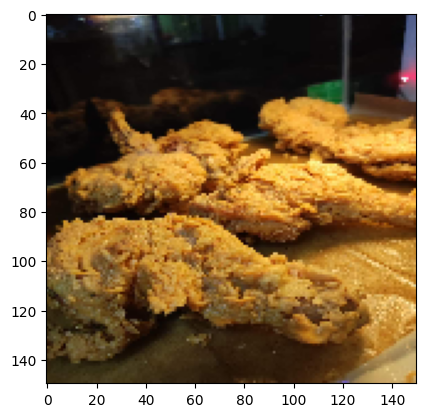


Image prediction result 1:  ayam krispi   99.99957084655762 %

Image prediction result 2:  nasi_goreng   0.00021763169115729397 %

Image prediction result 3:  ice_cream   0.0001428396444680402 %


1/1 [==============================] - 0s 63ms/step




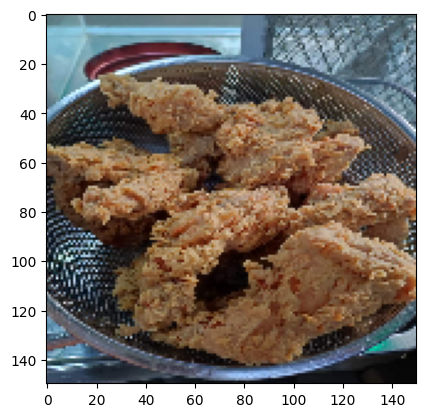


Image prediction result 1:  ayam krispi   95.78444361686707 %

Image prediction result 2:  ice_cream   4.1075993329286575 %

Image prediction result 3:  bakso   0.076541758608073 %


1/1 [==============================] - 0s 89ms/step




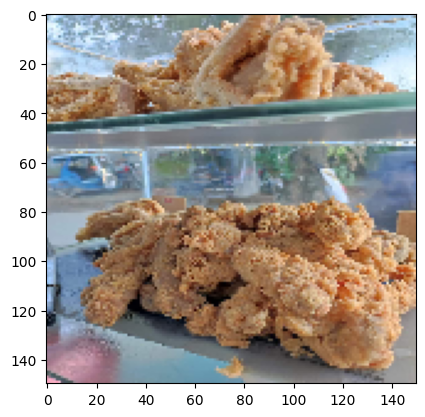


Image prediction result 1:  ayam krispi   99.58337545394897 %

Image prediction result 2:  ice_cream   0.41255163960158825 %

Image prediction result 3:  bakwan   0.004069647548021749 %


1/1 [==============================] - 0s 38ms/step




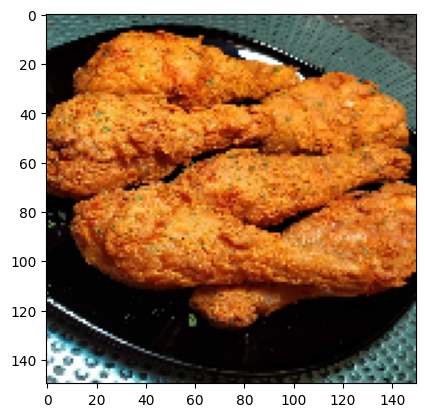


Image prediction result 1:  ayam krispi   100.0 %

Image prediction result 2:  kentang_goreng   5.315785500670245e-06 %

Image prediction result 3:  bakwan   3.246048395355583e-10 %


1/1 [==============================] - 0s 46ms/step




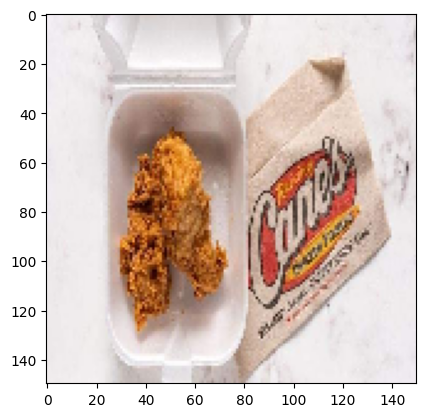


Image prediction result 1:  Donut   67.1069860458374 %

Image prediction result 2:  nasi_kuning   16.175498068332672 %

Image prediction result 3:  bakso   15.737269818782806 %


1/1 [==============================] - 0s 36ms/step




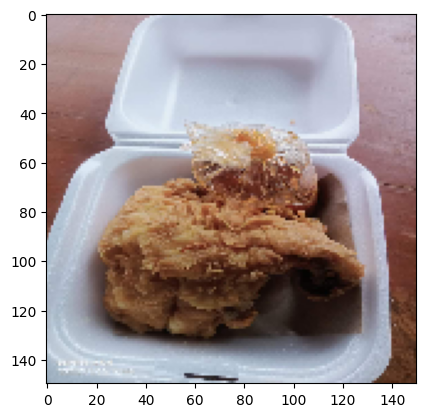


Image prediction result 1:  ayam krispi   98.49594235420227 %

Image prediction result 2:  burger   1.5030399896204472 %

Image prediction result 3:  nasi_goreng   0.0009222262633556966 %


1/1 [==============================] - 0s 35ms/step




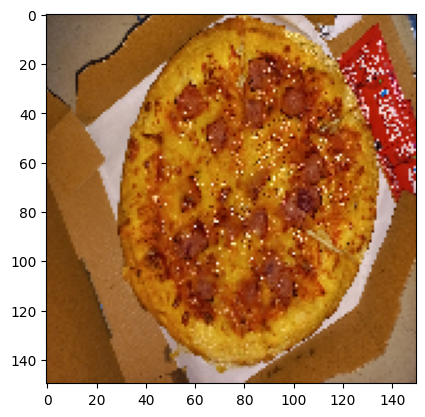


Image prediction result 1:  pizza   100.0 %

Image prediction result 2:  burger   8.457666789141172e-08 %

Image prediction result 3:  bakso   7.141122173031245e-13 %


1/1 [==============================] - 0s 35ms/step




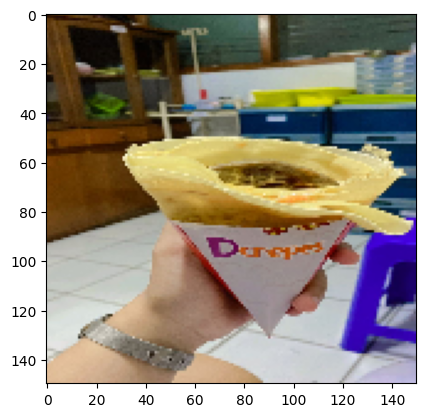


Image prediction result 1:  ice_cream   95.55795788764954 %

Image prediction result 2:  crepes   4.381256550550461 %

Image prediction result 3:  kebab   0.06075020646676421 %


1/1 [==============================] - 0s 36ms/step




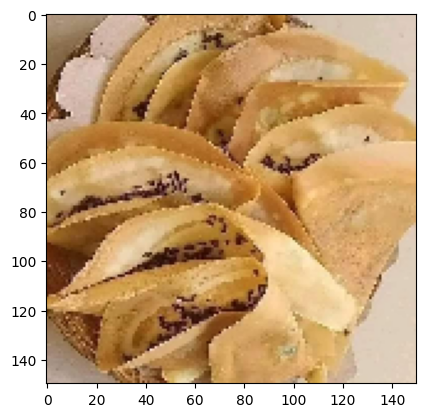


Image prediction result 1:  crepes   52.938371896743774 %

Image prediction result 2:  kentang_goreng   47.014012932777405 %

Image prediction result 3:  burger   0.04643555439542979 %


1/1 [==============================] - 0s 49ms/step




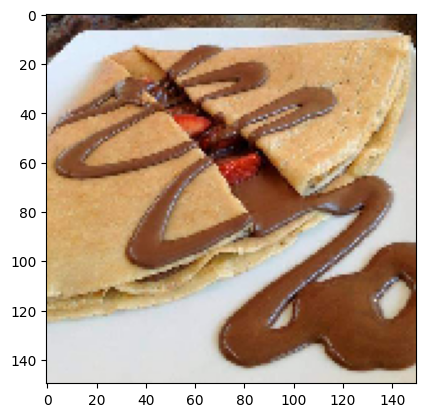


Image prediction result 1:  cheesecake   100.0 %

Image prediction result 2:  pizza   1.2207791222351716e-06 %

Image prediction result 3:  ice_cream   3.145293192563514e-08 %


1/1 [==============================] - 0s 40ms/step




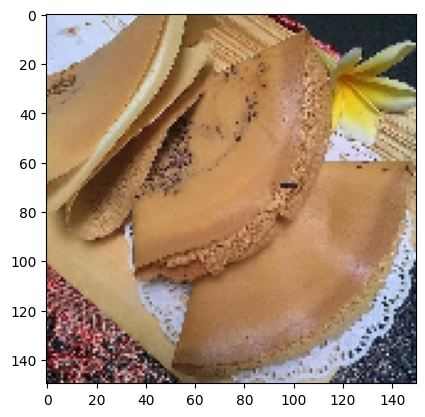


Image prediction result 1:  ice_cream   99.93290901184082 %

Image prediction result 2:  cheesecake   0.06691046291962266 %

Image prediction result 3:  Donut   0.00018554422922534286 %


1/1 [==============================] - 0s 75ms/step




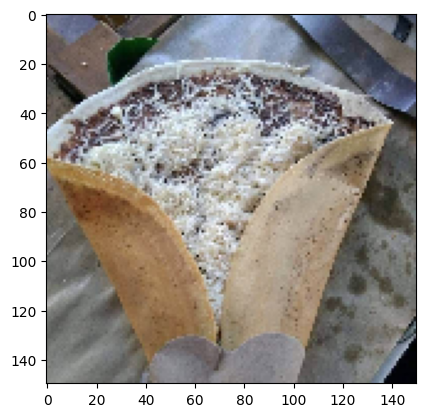


Image prediction result 1:  ice_cream   94.77423429489136 %

Image prediction result 2:  cheesecake   3.8815949112176895 %

Image prediction result 3:  crepes   0.9070567786693573 %


1/1 [==============================] - 0s 55ms/step




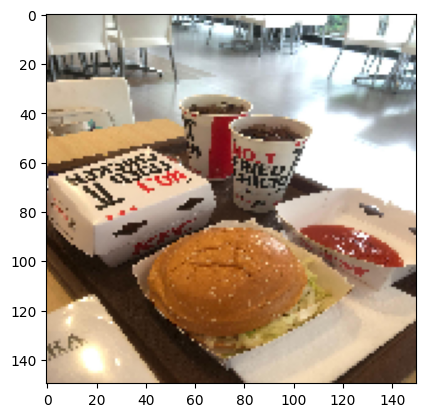


Image prediction result 1:  pizza   91.6013777256012 %

Image prediction result 2:  burger   8.327202498912811 %

Image prediction result 3:  nasi_kuning   0.04138173826504499 %


1/1 [==============================] - 0s 64ms/step




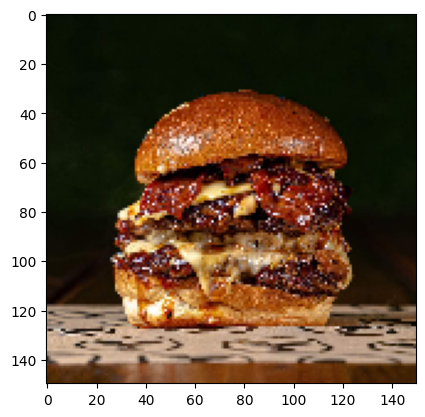


Image prediction result 1:  burger   100.0 %

Image prediction result 2:  ayam krispi   4.1398218309171083e-16 %

Image prediction result 3:  kentang_goreng   1.2585008890247621e-17 %


1/1 [==============================] - 0s 61ms/step




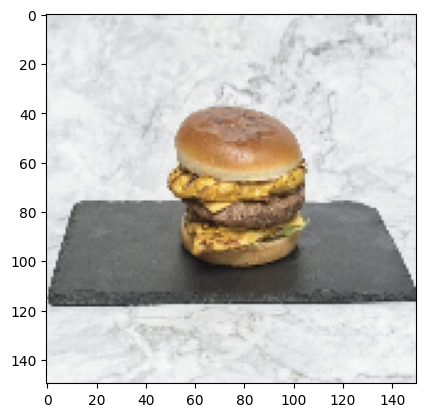


Image prediction result 1:  burger   99.99775886535645 %

Image prediction result 2:  Donut   0.002091110945912078 %

Image prediction result 3:  ayam krispi   0.000145179421906505 %


1/1 [==============================] - 0s 35ms/step




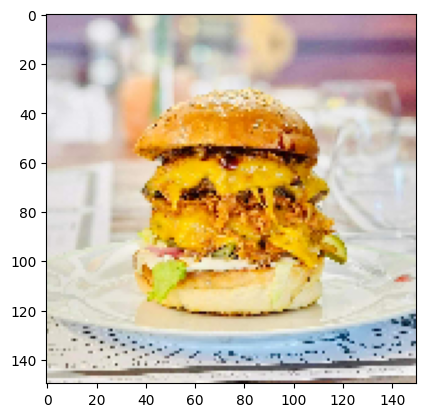


Image prediction result 1:  burger   100.0 %

Image prediction result 2:  ayam krispi   1.414174762637613e-13 %

Image prediction result 3:  kentang_goreng   1.7524236521603393e-15 %


1/1 [==============================] - 0s 37ms/step




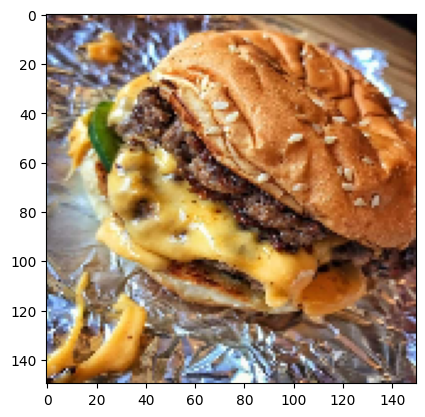


Image prediction result 1:  burger   99.99998807907104 %

Image prediction result 2:  cheesecake   6.7975399531405856e-06 %

Image prediction result 3:  ice_cream   1.466396870597464e-06 %


1/1 [==============================] - 0s 35ms/step




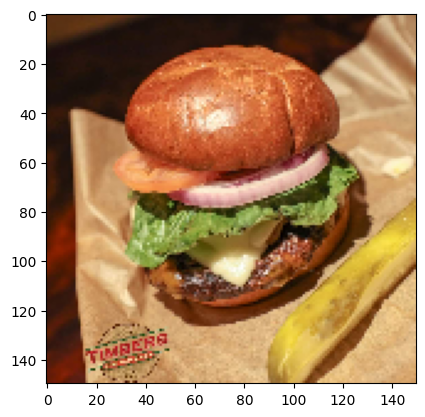


Image prediction result 1:  burger   100.0 %

Image prediction result 2:  ice_cream   3.387496721101914e-16 %

Image prediction result 3:  ayam krispi   5.226095202264134e-19 %


1/1 [==============================] - 0s 38ms/step




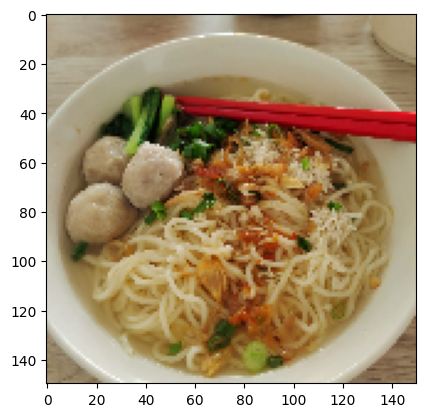


Image prediction result 1:  bakso   96.61263823509216 %

Image prediction result 2:  nasi_goreng   3.3741936087608337 %

Image prediction result 3:  ice_cream   0.008786065882304683 %


1/1 [==============================] - 0s 41ms/step




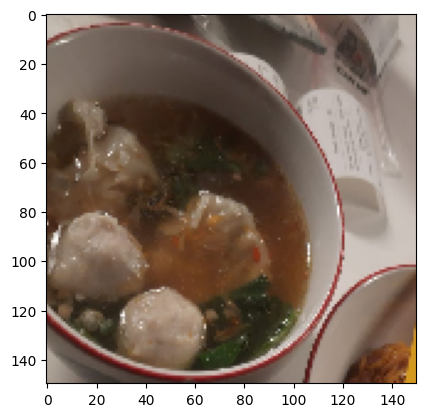


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  ice_cream   1.3304603252439762e-08 %

Image prediction result 3:  nasi_goreng   6.749945840846738e-13 %


1/1 [==============================] - 0s 36ms/step




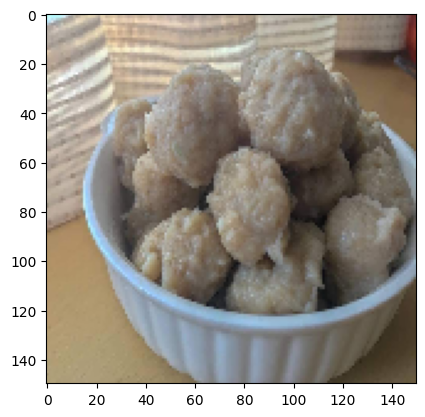


Image prediction result 1:  ice_cream   43.61920356750488 %

Image prediction result 2:  bakso   39.86144959926605 %

Image prediction result 3:  Donut   16.393089294433594 %


1/1 [==============================] - 0s 36ms/step




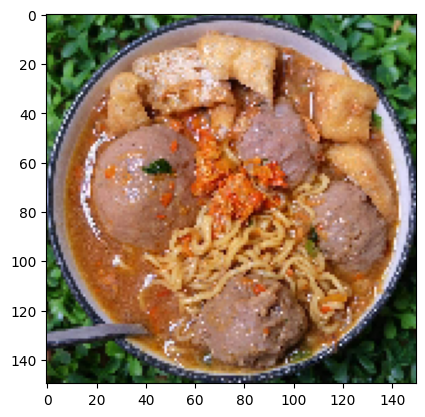


Image prediction result 1:  bakso   85.24463176727295 %

Image prediction result 2:  pizza   14.745190739631653 %

Image prediction result 3:  ayam krispi   0.01001593773253262 %


1/1 [==============================] - 0s 66ms/step




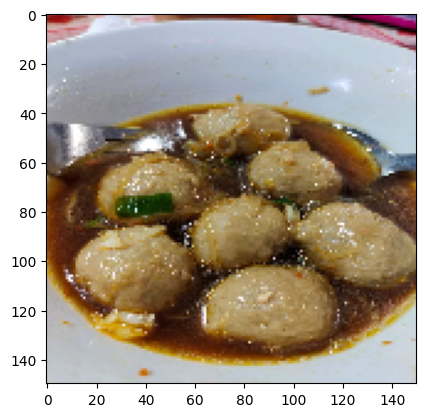


Image prediction result 1:  cheesecake   99.99992847442627 %

Image prediction result 2:  bakso   7.033651741039648e-05 %

Image prediction result 3:  Donut   8.030828085869857e-09 %


1/1 [==============================] - 0s 40ms/step




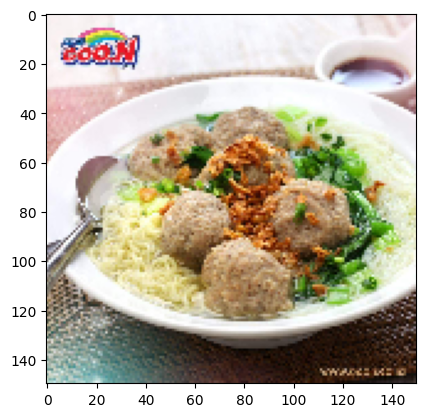


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  nasi_goreng   3.1908079733966588e-06 %

Image prediction result 3:  ayam krispi   1.5418964993685336e-07 %


1/1 [==============================] - 0s 42ms/step




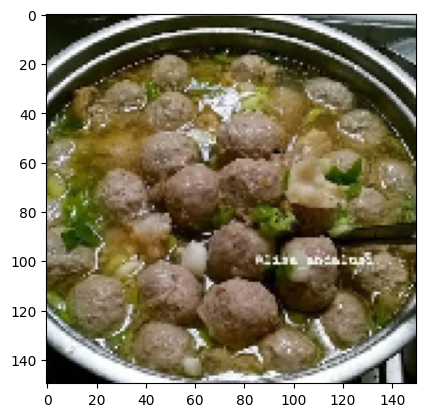


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  nasi_goreng   2.2794782728041696e-08 %

Image prediction result 3:  bakwan   3.2905206337474624e-09 %


1/1 [==============================] - 0s 50ms/step




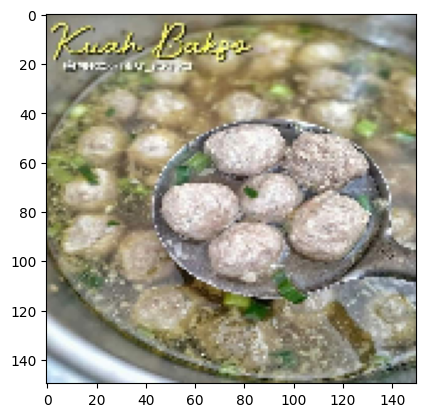


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  Donut   6.960059750760195e-08 %

Image prediction result 3:  bakwan   3.3556254996902624e-09 %


1/1 [==============================] - 0s 50ms/step




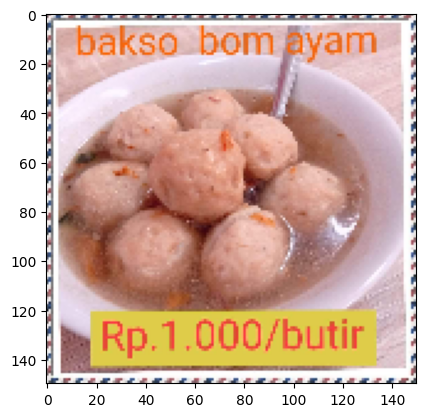


Image prediction result 1:  bakso   99.99998807907104 %

Image prediction result 2:  Donut   1.2257774528734444e-05 %

Image prediction result 3:  ice_cream   8.083232000410945e-10 %


1/1 [==============================] - 0s 36ms/step




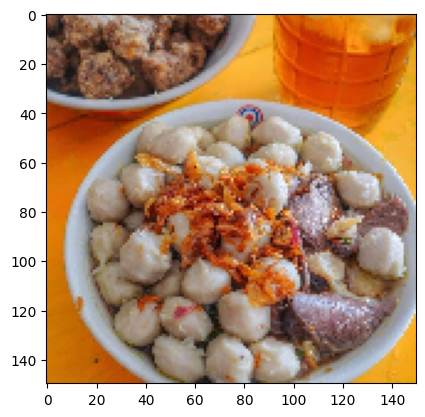


Image prediction result 1:  bakso   99.98522996902466 %

Image prediction result 2:  nasi_goreng   0.010032888530986384 %

Image prediction result 3:  cheesecake   0.004507297489908524 %


1/1 [==============================] - 0s 36ms/step




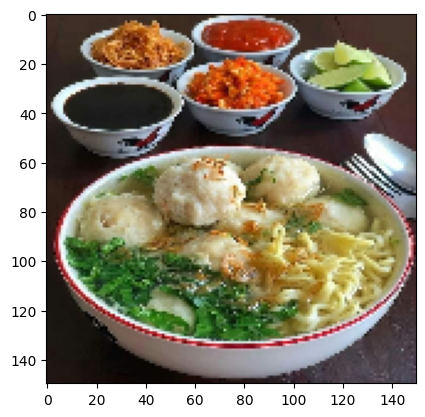


Image prediction result 1:  bakso   95.52962183952332 %

Image prediction result 2:  nasi_goreng   4.466071352362633 %

Image prediction result 3:  ice_cream   0.0031810926884645596 %


1/1 [==============================] - 0s 37ms/step




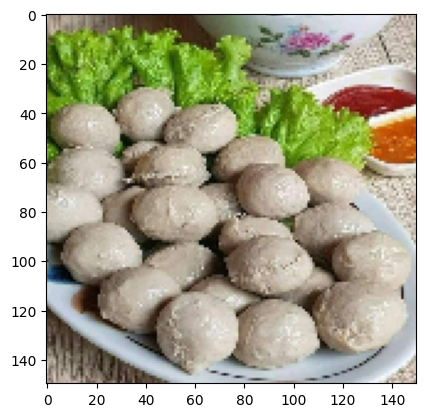


Image prediction result 1:  bakso   99.99972581863403 %

Image prediction result 2:  Donut   0.0002691582722036401 %

Image prediction result 3:  ice_cream   4.700512548638791e-09 %


1/1 [==============================] - 0s 38ms/step




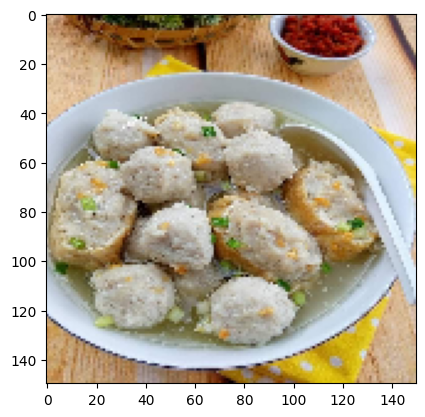


Image prediction result 1:  bakso   99.99998807907104 %

Image prediction result 2:  ice_cream   3.80366032004531e-06 %

Image prediction result 3:  ayam krispi   3.6671096381724055e-06 %


1/1 [==============================] - 0s 37ms/step




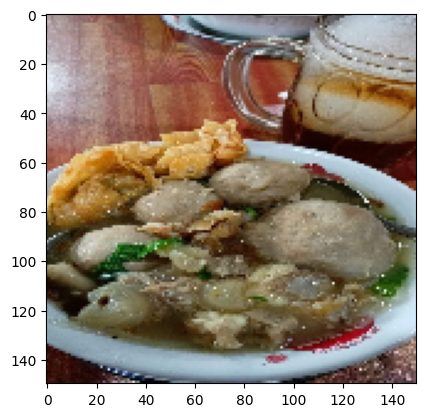


Image prediction result 1:  bakso   99.99898672103882 %

Image prediction result 2:  ayam krispi   0.0010100357030751184 %

Image prediction result 3:  pizza   2.8201498025737237e-06 %


1/1 [==============================] - 0s 38ms/step




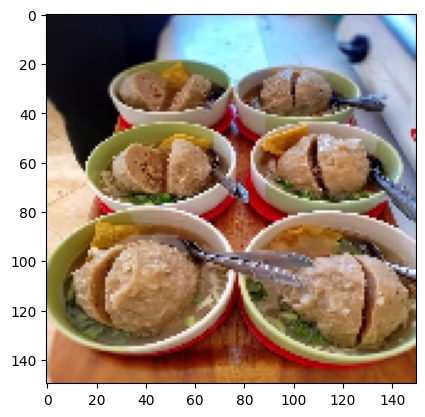


Image prediction result 1:  ice_cream   64.28366303443909 %

Image prediction result 2:  bakso   35.61148941516876 %

Image prediction result 3:  kebab   0.10232864879071712 %


1/1 [==============================] - 0s 36ms/step




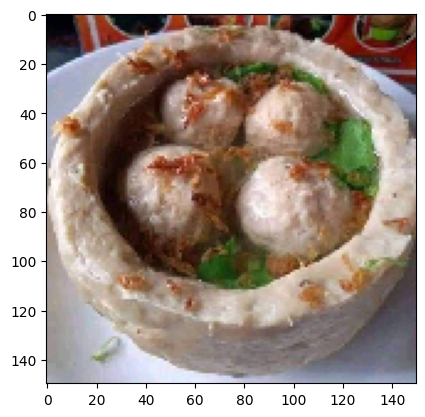


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  ice_cream   3.8837999483121166e-08 %

Image prediction result 3:  bakwan   1.464493457059568e-10 %


1/1 [==============================] - 0s 34ms/step




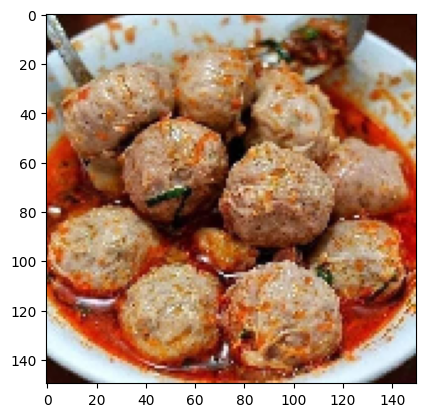


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  Donut   1.6016018733466808e-06 %

Image prediction result 3:  ayam krispi   9.785083854296772e-09 %


1/1 [==============================] - 0s 34ms/step




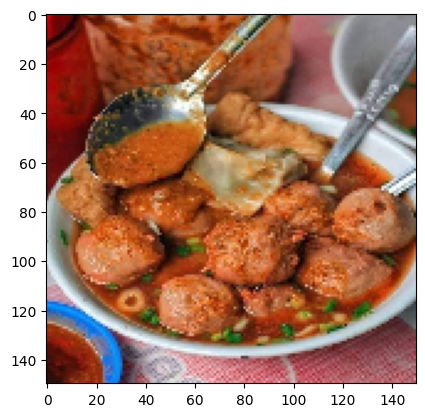


Image prediction result 1:  bakso   99.99817609786987 %

Image prediction result 2:  bakwan   0.0014847277270746417 %

Image prediction result 3:  ayam krispi   0.00030402511583815794 %


1/1 [==============================] - 0s 38ms/step




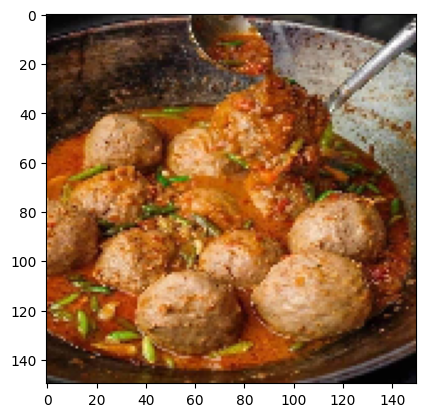


Image prediction result 1:  bakso   100.0 %

Image prediction result 2:  ayam krispi   4.584046919831053e-07 %

Image prediction result 3:  ice_cream   3.7805657042422336e-10 %


1/1 [==============================] - 0s 45ms/step




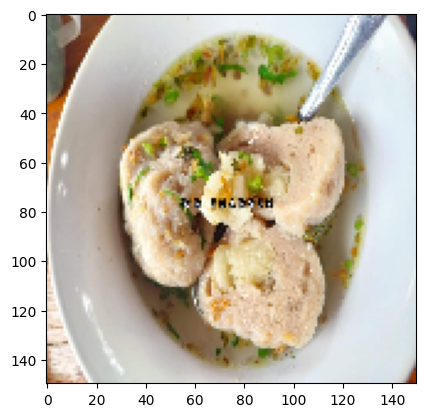


Image prediction result 1:  bakso   99.9085783958435 %

Image prediction result 2:  bakwan   0.07490878342650831 %

Image prediction result 3:  nasi_goreng   0.016370626690331846 %


1/1 [==============================] - 0s 74ms/step




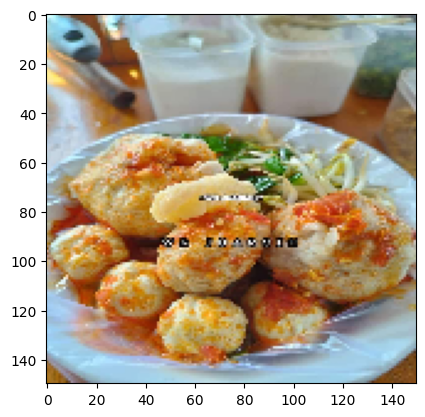


Image prediction result 1:  bakso   99.99812841415405 %

Image prediction result 2:  ayam krispi   0.0013862849300494418 %

Image prediction result 3:  Donut   0.0004495529083214933 %


1/1 [==============================] - 0s 81ms/step




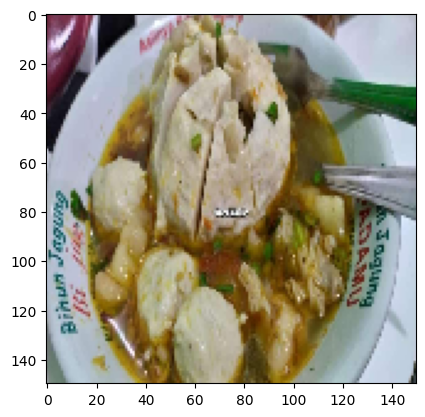


Image prediction result 1:  bakwan   78.83816957473755 %

Image prediction result 2:  bakso   20.33090442419052 %

Image prediction result 3:  kentang_goreng   0.44988151639699936 %


1/1 [==============================] - 0s 40ms/step




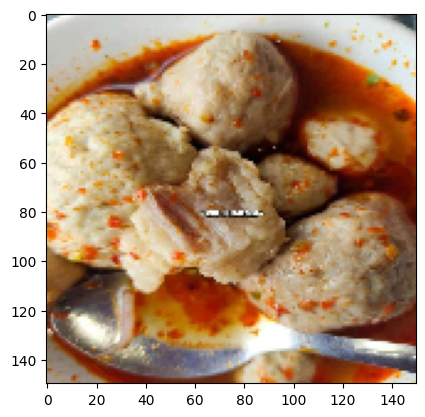


Image prediction result 1:  pizza   95.23683190345764 %

Image prediction result 2:  bakso   2.53194160759449 %

Image prediction result 3:  ice_cream   1.7211627215147018 %


1/1 [==============================] - 0s 75ms/step




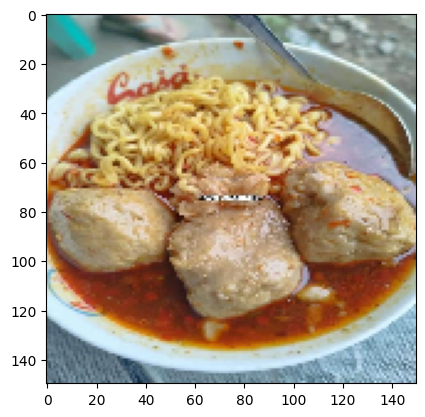


Image prediction result 1:  bakso   76.88925862312317 %

Image prediction result 2:  pizza   23.07366132736206 %

Image prediction result 3:  kentang_goreng   0.024911167565733194 %


1/1 [==============================] - 0s 70ms/step




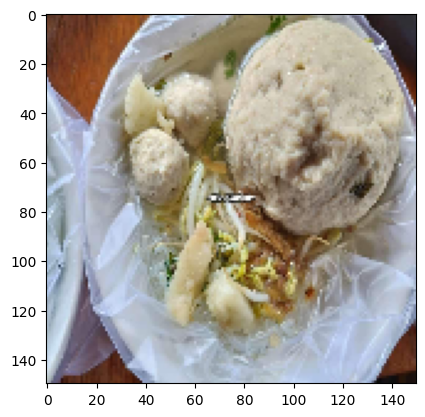


Image prediction result 1:  bakso   75.84478259086609 %

Image prediction result 2:  ice_cream   19.20057386159897 %

Image prediction result 3:  nasi_goreng   4.954646900296211 %


1/1 [==============================] - 0s 35ms/step




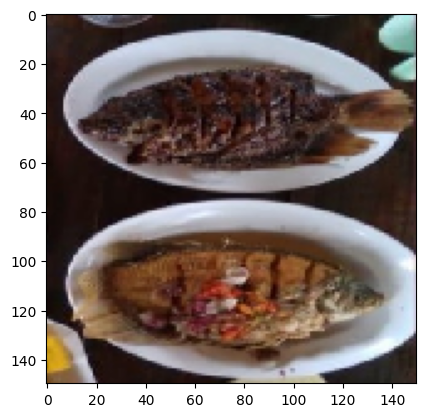


Image prediction result 1:  ikan   90.83775877952576 %

Image prediction result 2:  pizza   3.6836545914411545 %

Image prediction result 3:  nasi_goreng   2.809055335819721 %




In [ ]:
import numpy as np
from tensorflow.keras.utils import load_img, img_to_array
import matplotlib.pyplot as plt
import os
test_path = '/content/drive/MyDrive/TEST DATA'
for folder in os.listdir(test_path):
  for filename in os.listdir(os.path.join(test_path, folder)):
    img = load_img(os.path.join(test_path, os.path.join(folder, filename)), target_size=(150,150))
    imgplot = plt.imshow(img)
    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    img = np.vstack([x])
    predict_image(img)

### Predict the model using upload file

In [ ]:
from google.colab import files
import numpy as np
from tensorflow.keras.utils import load_img, img_to_array
import matplotlib.pyplot as plt
uploaded = files.upload()

for fn in uploaded.keys():
  path = fn
  img = load_img(path, target_size=(150,150))
  imgplot = plt.imshow(img)
  x = img_to_array(img)
  x = np.expand_dims(x, axis=0)
  img = np.vstack([x])

predict_image(img)